In [207]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/주일', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 매개변수를 반복
for page in range(1, 32):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?boardID=www42&keyfield=&key=&bCate=%EC%A3%BC%EC%9D%BC&page={page}"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        style_attr = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', style_attr)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/주일', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


Failed to download subpage image: HTTPSConnectionPool(host='www.jungchim.com', port=443): Max retries exceeded with url: /user/saveDir/board/www42/29325_1458008483_16.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x173cf97f0>, 'Connection to www.jungchim.com timed out. (connect timeout=None)'))


In [208]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/행사', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 매개변수를 반복
for page in range(1, 34):  # 페이지 범위 수정
    # 페이지에 따른 URL 조합
    url = f"{base_url}?boardID=www42&keyfield=&key=&bCate=%ED%96%89%EC%82%AC&page={page}"  # URL 수정

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        style_attr = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', style_attr)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/행사', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


Failed to download subpage image: HTTPSConnectionPool(host='www.jungchim.com', port=443): Max retries exceeded with url: /user/saveDir/board/www42/28351_1266829703_16.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x1699155b0>, 'Connection to www.jungchim.com timed out. (connect timeout=None)'))


In [209]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/영아', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 7

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?boardID=www42&keyfield=&key=&bCate=%EC%98%81%EC%95%84&page={page}"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        style_attr = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', style_attr)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/영아', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


Failed to download subpage image: HTTPSConnectionPool(host='www.jungchim.com', port=443): Max retries exceeded with url: /user/saveDir/board/www42/29312_1456204073_20.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x17246c860>, 'Connection to www.jungchim.com timed out. (connect timeout=None)'))


In [216]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/초등', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 4

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%B4%88%EB%93%B1"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/초등', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [224]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/무디', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 7

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EB%AC%B4%EB%94%94"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/무디', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


Failed to download image: Invalid URL '/core/public/images/noimg_main.gif': No scheme supplied. Perhaps you meant https:///core/public/images/noimg_main.gif?


In [218]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/중등', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 3

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%A4%91%EB%93%B1"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/중등', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [219]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/청소년', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 8

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%B2%AD%EC%86%8C%EB%85%84"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/청소년', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [220]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/청년', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 8

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%B2%AD%EB%85%84"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/청년', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [221]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/사랑', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 1

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%82%AC%EB%9E%91"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/사랑', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [222]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/유년', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 25

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EC%9C%A0%EB%85%84"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/유년', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


In [223]:
import os
import re
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin

# 저장할 디렉토리 생성
os.makedirs('images/기타', exist_ok=True)

# 기본 URL
base_url = 'https://www.jungchim.com/main/sub.html'

# 페이지 범위 설정
max_page = 82

# 페이지 매개변수를 반복
for page in range(1, max_page + 1):
    # 페이지에 따른 URL 조합
    url = f"{base_url}?page={page}&boardID=www42&keyfield=&key=&bCate=%EA%B8%B0%ED%83%80"

    # 상위 페이지 요청
    try:
        response = requests.get(url)
        if response.status_code != 200:
            print(f"Failed to retrieve {url}")
            continue
        response.encoding = 'UTF-8'
        soup = BeautifulSoup(response.text, 'html.parser')
    except requests.RequestException as e:
        print(f"Request failed: {e}")
        continue

    # 이미지 태그 찾기
    image_tags = soup.find_all('div', class_='mdPhotoArea')

    # 마지막 리스트부터 폴더를 만들고 이미지 저장
    for tag in reversed(image_tags):
        # 이미지 URL 추출
        image_style = tag.find('p', class_='photoimage')['style']
        match = re.search(r'url\((.*?)\)', image_style)
        if match:
            image_url = match.group(1)

            # 등록일 추출
            register_date = tag.find('span', class_='caption fade-caption').text.strip()
            register_date_match = re.search(r'등록일 (\d{4}\.\d{2}\.\d{2})', register_date)
            if register_date_match:
                register_date = register_date_match.group(1)

                # 제목 추출
                ancestor = tag.parent
                while ancestor and not ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj'):
                    ancestor = ancestor.parent
                if ancestor:
                    title_tag = ancestor.find('div', class_='mdDefaultW100 mdPhoto_sbj')
                    title_text = title_tag.find('a', class_='mdTextOverflow').text.strip() if title_tag else 'Unknown Title'
                else:
                    title_text = 'Unknown Title'

                # 특수 문자 제거 및 치환
                folder_name = re.sub(r'[\/:*?"<>|]', '', title_text).strip()

                # 폴더명 생성
                folder_path = os.path.join('images/기타', f'{register_date}_{folder_name}')
                os.makedirs(folder_path, exist_ok=True)

                # 이미지 저장
                try:
                    img_data = requests.get(image_url).content
                    with open(os.path.join(folder_path, f'{folder_name}_{register_date}.jpg'), 'wb') as f:
                        f.write(img_data)
                except requests.RequestException as e:
                    print(f"Failed to download image: {e}")
                    continue

                # 하위 페이지 URL 추출 및 이동
                sub_url = tag.find('a')['href']
                absolute_sub_url = urljoin(url, sub_url)
                try:
                    sub_response = requests.get(absolute_sub_url)
                    if sub_response.status_code != 200:
                        continue
                    sub_response.encoding = 'UTF-8'
                    sub_soup = BeautifulSoup(sub_response.text, 'html.parser')
                except requests.RequestException as e:
                    print(f"Request failed: {e}")
                    continue

                # 하위 페이지에서 이미지 정보 가져오기 및 이미지 저장
                sub_image_tags = sub_soup.find_all('img', id=re.compile(r'ANYBOARDVIEWIMAGE_\d+'))
                for i, sub_image_tag in enumerate(sub_image_tags):
                    sub_image_src = sub_image_tag['src']
                    sub_image_url = urljoin(absolute_sub_url, sub_image_src)
                    try:
                        sub_img_data = requests.get(sub_image_url).content
                        sub_filename = f'{folder_name}_{i+1}_{register_date}'
                        with open(os.path.join(folder_path, f'{sub_filename}.jpg'), 'wb') as f:
                            f.write(sub_img_data)
                    except requests.RequestException as e:
                        print(f"Failed to download subpage image: {e}")
                        continue


Failed to download subpage image: HTTPSConnectionPool(host='www.jungchim.com', port=443): Max retries exceeded with url: /user/saveDir/board/www42/29629_1490768988_1.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x16893b2c0>, 'Connection to www.jungchim.com timed out. (connect timeout=None)'))
Failed to download subpage image: HTTPSConnectionPool(host='www.jungchim.com', port=443): Max retries exceeded with url: /user/saveDir/board/www42/28374_1270637388_19.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x172b6c230>, 'Connection to www.jungchim.com timed out. (connect timeout=None)'))
Failed to download image: Invalid URL '/core/public/images/noimg_main.gif': No scheme supplied. Perhaps you meant https:///core/public/images/noimg_main.gif?
Failed to download image: Invalid URL '/core/public/images/noimg_main.gif': No scheme supplied. Perhaps you meant https:///core/public/images/noimg_main.gif?
Failed to download imag

In [233]:
import os
import pandas as pd

# 폴더 경로를 저장할 데이터 프레임 생성
folder_df = pd.DataFrame(columns=['폴더1', '폴더2', '폴더3'])

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 경로를 데이터 프레임에 추가하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth < 4:  # 마지막 단계 이전까지만 폴더 경로를 리스트업
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    # 폴더명을 포함한 리스트 생성
                    row = parent_folders + [item] + [''] * (2 - depth) # 최대 폴더 수를 3으로 가정
                    folder_df.loc[len(folder_df)] = row
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터 프레임 출력
folder_df


,폴더1,폴더2,폴더3
0,기타,,
1,기타,2013,
2,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사
3,기타,2013,2013.03.19_0318 예마본 특별새벽부흥회 시작
4,기타,2013,2013.09.03_0902 연합체육대회- 여자발야구 2
...,...,...,...
3332,주일,2016,2016.04.05_0403 오후예배-느헤미야 대탐험 둘째주
3333,주일,2016,2016.02.02_0131 마가복음 성경골든벨 1
3334,주일,2016,2016.04.27_0424 오후예배-에스더 대탐험 둘째주
3335,주일,2016,2016.10.11_1009 성경골든벨-누가복음1


In [234]:
folder_df.head(20)

,폴더1,폴더2,폴더3
0,기타,,
1,기타,2013,
2,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사
3,기타,2013,2013.03.19_0318 예마본 특별새벽부흥회 시작
4,기타,2013,2013.09.03_0902 연합체육대회- 여자발야구 2
5,기타,2013,2013.05.15_0510 금요심야기도회-성경대탐험
6,기타,2013,2013.11.09_10월12일 아가페컵축구대회2
7,기타,2013,2013.10.29_1028 특새-VIP위한
8,기타,2013,2013.10.01_0927 금요심야기도회 모습
9,기타,2013,2013.05.09_0506 다니엘 야외체육활동


In [235]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량
0,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,21,4059680
1,기타,2013,2013.03.19_0318 예마본 특별새벽부흥회 시작,21,4522698
2,기타,2013,2013.09.03_0902 연합체육대회- 여자발야구 2,25,5222765
3,기타,2013,2013.05.15_0510 금요심야기도회-성경대탐험,31,5921201
4,기타,2013,2013.11.09_10월12일 아가페컵축구대회2,11,3647613
...,...,...,...,...,...
3152,주일,2016,2016.04.05_0403 오후예배-느헤미야 대탐험 둘째주,25,7691243
3153,주일,2016,2016.02.02_0131 마가복음 성경골든벨 1,23,8264173
3154,주일,2016,2016.04.27_0424 오후예배-에스더 대탐험 둘째주,17,5103024
3155,주일,2016,2016.10.11_1009 성경골든벨-누가복음1,73,13348969


In [237]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량, 등록일, 제목을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량, 등록일, 제목을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
                    # 파일명에서 등록일과 제목 추출
                    file_name = os.path.splitext(item)[0]  # 파일명에서 확장자를 제외한 부분을 가져옴
                    parts = file_name.split('_')
                    if len(parts) > 1:
                        register_date = parts[0]  # "_" 이전은 등록일
                        title = '_'.join(parts[1:])  # "_" 이후는 제목
                    else:
                        register_date = ""
                        title = file_name
                    folder_data.append({
                        '폴더1': parent_folders[0],
                        '폴더2': parent_folders[1],
                        '폴더3': parent_folders[2],
                        '등록일': register_date,
                        '제목': title,
                        '사진수': file_count,
                        '용량': total_size
                    })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,등록일,제목,사진수,용량
0,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,20_2013.05.10,1,248009
1,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,14_2013.05.10,2,445678
2,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,2_2013.05.10,3,640400
3,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,13_2013.05.10,4,834379
4,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,5_2013.05.10,5,1054966
...,...,...,...,...,...,...,...
81813,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,19_2016.08.04,29,8859646
81814,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,16_2016.08.04,30,9128620
81815,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,17_2016.08.04,31,9404818
81816,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,18_2016.08.04,32,9652680


In [239]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
                    # 파일명을 "_"를 기준으로 분리하여 등록일과 제목을 추출
                    parts = item.split('_')
                    if len(parts) > 1:
                        register_date = parts[0]  # "_" 이전은 등록일
                        title3 = '_'.join(parts[1:])  # "_" 이후는 제목3
                    else:
                        register_date = ""
                        title3 = item  # "_"가 없는 경우 파일명 전체를 제목3으로 설정
                    folder_data.append({
                        '폴더1': parent_folders[0],
                        '폴더2': parent_folders[1],
                        '폴더3': parent_folders[2],
                        '등록일': register_date,
                        '제목3': title3,
                        '사진수': file_count,
                        '용량': total_size
                    })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,등록일,제목3,사진수,용량
0,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,20_2013.05.10.jpg,1,248009
1,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,14_2013.05.10.jpg,2,445678
2,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,2_2013.05.10.jpg,3,640400
3,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,13_2013.05.10.jpg,4,834379
4,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,0509 중앙실버대학 어버이날 행사,5_2013.05.10.jpg,5,1054966
...,...,...,...,...,...,...,...
81813,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,19_2016.08.04.jpg,29,8859646
81814,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,16_2016.08.04.jpg,30,9128620
81815,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,17_2016.08.04.jpg,31,9404818
81816,주일,2016,2016.08.04_0731 오후예배-해외단기선교보고,0731 오후예배-해외단기선교보고,18_2016.08.04.jpg,32,9652680


In [240]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1]
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량
0,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,21,4059680
1,기타,2013,2013.03.19_0318 예마본 특별새벽부흥회 시작,21,4522698
2,기타,2013,2013.09.03_0902 연합체육대회- 여자발야구 2,25,5222765
3,기타,2013,2013.05.15_0510 금요심야기도회-성경대탐험,31,5921201
4,기타,2013,2013.11.09_10월12일 아가페컵축구대회2,11,3647613
...,...,...,...,...,...
3152,주일,2016,2016.04.05_0403 오후예배-느헤미야 대탐험 둘째주,25,7691243
3153,주일,2016,2016.02.02_0131 마가복음 성경골든벨 1,23,8264173
3154,주일,2016,2016.04.27_0424 오후예배-에스더 대탐험 둘째주,17,5103024
3155,주일,2016,2016.10.11_1009 성경골든벨-누가복음1,73,13348969


In [243]:
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1]

In [244]:
folder_df.head()

,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,기타,2013,2013.05.10_0509 중앙실버대학 어버이날 행사,21,4059680,2013.05.10,0509 중앙실버대학 어버이날 행사
1,기타,2013,2013.03.19_0318 예마본 특별새벽부흥회 시작,21,4522698,2013.03.19,0318 예마본 특별새벽부흥회 시작
2,기타,2013,2013.09.03_0902 연합체육대회- 여자발야구 2,25,5222765,2013.09.03,0902 연합체육대회- 여자발야구 2
3,기타,2013,2013.05.15_0510 금요심야기도회-성경대탐험,31,5921201,2013.05.15,0510 금요심야기도회-성경대탐험
4,기타,2013,2013.11.09_10월12일 아가페컵축구대회2,11,3647613,2013.11.09,10월12일 아가페컵축구대회2


In [246]:
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)
folder_df.head()

,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,무디,2009,2009.05.03_무디부 베드로반,6,1389494,2009.05.03,무디부 베드로반
1,무디,2009,2009.06.03_무디부 주말캠프 1,48,13280104,2009.06.03,무디부 주말캠프 1
2,무디,2009,2009.06.03_무디부 주말캠프 2,45,11917551,2009.06.03,무디부 주말캠프 2
3,무디,2009,2009.07.25_유년무디부 여름성경학교 셋째날,51,14392136,2009.07.25,유년무디부 여름성경학교 셋째날
4,무디,2009,2009.07.25_유년무디부 여름성경학교 첫째날,39,10837850,2009.07.25,유년무디부 여름성경학교 첫째날


In [247]:
folder_df["폴더1"].unique()

array(['무디', '기타', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년',
       '초등', '행사'], dtype=object)

In [248]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth <= 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0] if len(parent_folders) >= 1 else '',
            '폴더2': parent_folders[1] if len(parent_folders) >= 2 else '',
            '폴더3': parent_folders[2] if len(parent_folders) >= 3 else '',
            '사진수': file_count,
            '용량': total_size
        })
    else:
        return  # 깊이가 3을 초과하면 함수를 종료하여 재귀 호출을 멈춥니다.
        
    for item in os.listdir(directory):
        item_path = os.path.join(directory, item)
        if os.path.isdir(item_path):
            if item != 'ds':  # "ds" 폴더 제외
                explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1]
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,,,,0,0,,NaN
1,무디,,,0,0,,NaN
2,무디,2013,,0,0,,NaN
3,무디,2014,,0,0,,NaN
4,무디,2022,,0,0,,NaN
...,...,...,...,...,...,...,...
3333,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3334,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3335,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3336,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [249]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth <= 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0] if len(parent_folders) >= 1 else '',
            '폴더2': parent_folders[1] if len(parent_folders) >= 2 else '',
            '폴더3': parent_folders[2] if len(parent_folders) >= 3 else '',
            '사진수': file_count,
            '용량': total_size
        })
        
    for item in os.listdir(directory):
        item_path = os.path.join(directory, item)
        if os.path.isdir(item_path):
            if item != 'ds':  # "ds" 폴더 제외
                explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1]
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,,,,0,0,,NaN
1,무디,,,0,0,,NaN
2,무디,2013,,0,0,,NaN
3,무디,2014,,0,0,,NaN
4,무디,2022,,0,0,,NaN
...,...,...,...,...,...,...,...
3333,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3334,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3335,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3336,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [251]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1].fillna(folder_df["폴더3"])
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,무디,2009,2009.05.03_무디부 베드로반,6,1389494,2009.05.03,무디부 베드로반
1,무디,2009,2009.06.03_무디부 주말캠프 1,48,13280104,2009.06.03,무디부 주말캠프 1
2,무디,2009,2009.06.03_무디부 주말캠프 2,45,11917551,2009.06.03,무디부 주말캠프 2
3,무디,2009,2009.07.25_유년무디부 여름성경학교 셋째날,51,14392136,2009.07.25,유년무디부 여름성경학교 셋째날
4,무디,2009,2009.07.25_유년무디부 여름성경학교 첫째날,39,10837850,2009.07.25,유년무디부 여름성경학교 첫째날
...,...,...,...,...,...,...,...
3152,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3153,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3154,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3155,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [254]:
folder_df["폴더1"].unique()

array(['무디', '기타', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년',
       '초등', '행사'], dtype=object)

In [258]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1].fillna(folder_df["폴더3"])
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,무디,2009,2009.05.03_무디부 베드로반,6,1389494,2009.05.03,무디부 베드로반
1,무디,2009,2009.06.03_무디부 주말캠프 1,48,13280104,2009.06.03,무디부 주말캠프 1
2,무디,2009,2009.06.03_무디부 주말캠프 2,45,11917551,2009.06.03,무디부 주말캠프 2
3,무디,2009,2009.07.25_유년무디부 여름성경학교 셋째날,51,14392136,2009.07.25,유년무디부 여름성경학교 셋째날
4,무디,2009,2009.07.25_유년무디부 여름성경학교 첫째날,39,10837850,2009.07.25,유년무디부 여름성경학교 첫째날
...,...,...,...,...,...,...,...
3152,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3153,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3154,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3155,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [255]:
folder_df["폴더1"].unique()

array(['무디', '기타', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년',
       '초등', '행사'], dtype=object)

In [256]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        if depth == 1:  # 폴더 1인 경우에만 폴더 1 정보를 추가
            folder_data.append({
                '폴더1': os.path.basename(directory),
                '폴더2': '',
                '폴더3': '',
                '사진수': 0,
                '용량': 0
            })
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1].fillna(folder_df["폴더3"])
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,무디,,,0,0,,
1,무디,2009,2009.05.03_무디부 베드로반,6,1389494,2009.05.03,무디부 베드로반
2,무디,2009,2009.06.03_무디부 주말캠프 1,48,13280104,2009.06.03,무디부 주말캠프 1
3,무디,2009,2009.06.03_무디부 주말캠프 2,45,11917551,2009.06.03,무디부 주말캠프 2
4,무디,2009,2009.07.25_유년무디부 여름성경학교 셋째날,51,14392136,2009.07.25,유년무디부 여름성경학교 셋째날
...,...,...,...,...,...,...,...
3164,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3165,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3166,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3167,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [257]:
folder_df["폴더1"].unique()

array(['무디', '기타', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년',
       '초등', '행사'], dtype=object)

In [259]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1].fillna(folder_df["폴더3"])
folder_df.sort_values(by=["폴더1", "등록일", "제목"], key=lambda x: x.str.encode('utf-8'), inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,무디,2009,2009.05.03_무디부 베드로반,6,1389494,2009.05.03,무디부 베드로반
1,무디,2009,2009.06.03_무디부 주말캠프 1,48,13280104,2009.06.03,무디부 주말캠프 1
2,무디,2009,2009.06.03_무디부 주말캠프 2,45,11917551,2009.06.03,무디부 주말캠프 2
3,무디,2009,2009.07.25_유년무디부 여름성경학교 셋째날,51,14392136,2009.07.25,유년무디부 여름성경학교 셋째날
4,무디,2009,2009.07.25_유년무디부 여름성경학교 첫째날,39,10837850,2009.07.25,유년무디부 여름성경학교 첫째날
...,...,...,...,...,...,...,...
3152,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3153,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3154,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3155,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [265]:
import os
import pandas as pd

# 폴더 정보와 파일 개수, 용량을 저장할 리스트 생성
folder_data = []

# 시작 디렉토리 경로
start_dir = '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images'

# 폴더의 실제 순서
folder_order = ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사']

# 디렉토리를 재귀적으로 탐색하고 폴더 정보, 파일 개수, 용량을 수집하는 함수
def explore_directory(directory, depth=0, parent_folders=[]):
    if depth == 3:  # 폴더 3까지만 탐색
        file_count = 0
        total_size = 0
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isfile(item_path):
                if item != '.DS_Store':  # Mac에서 자동 생성되는 .DS_Store 파일 제외
                    file_count += 1
                    total_size += os.path.getsize(item_path)
        folder_data.append({
            '폴더1': parent_folders[0],
            '폴더2': parent_folders[1],
            '폴더3': parent_folders[2],
            '사진수': file_count,
            '용량': total_size
        })
    else:
        for item in os.listdir(directory):
            item_path = os.path.join(directory, item)
            if os.path.isdir(item_path):
                if item != 'ds':  # "ds" 폴더 제외
                    explore_directory(item_path, depth + 1, parent_folders + [item])

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
folder_df = pd.DataFrame(folder_data)
folder_df["등록일"] = folder_df["폴더3"].str.split("_").str[0]
folder_df["제목"] = folder_df["폴더3"].str.split("_").str[1].fillna(folder_df["폴더3"])
folder_df["폴더1"] = pd.Categorical(folder_df["폴더1"], categories=folder_order, ordered=True)
folder_df.sort_values(by=["폴더1", "등록일", "제목"], inplace=True)
folder_df.reset_index(drop=True, inplace=True)

# 데이터프레임 출력
folder_df


,폴더1,폴더2,폴더3,사진수,용량,등록일,제목
0,기타,2005,2005.07.20_[030427] 김수진,2,53375,2005.07.20,[030427] 김수진
1,기타,2005,2005.07.20_[030427] 김재욱,2,61341,2005.07.20,[030427] 김재욱
2,기타,2005,2005.07.20_[030427] 김진명,2,58537,2005.07.20,[030427] 김진명
3,기타,2005,2005.07.20_[030427] 지석민,2,57738,2005.07.20,[030427] 지석민
4,기타,2005,2005.07.20_[030427]고해리,2,67465,2005.07.20,[030427]고해리
...,...,...,...,...,...,...,...
3152,행사,2024,2024.04.12_2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12,2024년 예마본 20일 기도회 15일차
3153,행사,2024,2024.04.15_2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15,2024년 예마본 20일 기도회 16일차
3154,행사,2024,2024.04.16_2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16,2024년 예마본 20일 기도회 17일차
3155,행사,2024,2024.04.17_2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17,2024년 예마본 20일 기도회 18일차


In [266]:
folder_df.rename(columns={'폴더1' : '상위폴더',
                          '폴더2':'년도폴더'}, inplace=True)

In [267]:
folder_df = folder_df[['상위폴더', '년도폴더', '제목', '사진수', '용량', '등록일']]

In [268]:
folder_df.head()

,상위폴더,년도폴더,제목,사진수,용량,등록일
0,기타,2005,[030427] 김수진,2,53375,2005.07.20
1,기타,2005,[030427] 김재욱,2,61341,2005.07.20
2,기타,2005,[030427] 김진명,2,58537,2005.07.20
3,기타,2005,[030427] 지석민,2,57738,2005.07.20
4,기타,2005,[030427]고해리,2,67465,2005.07.20


In [269]:
folder_df.to_excel('/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images/homepage_list.xlsx')

In [270]:
len(folder_df)

3157

In [271]:
folder_df

,상위폴더,년도폴더,제목,사진수,용량,등록일
0,기타,2005,[030427] 김수진,2,53375,2005.07.20
1,기타,2005,[030427] 김재욱,2,61341,2005.07.20
2,기타,2005,[030427] 김진명,2,58537,2005.07.20
3,기타,2005,[030427] 지석민,2,57738,2005.07.20
4,기타,2005,[030427]고해리,2,67465,2005.07.20
...,...,...,...,...,...,...
3152,행사,2024,2024년 예마본 20일 기도회 15일차,14,1558609,2024.04.12
3153,행사,2024,2024년 예마본 20일 기도회 16일차,8,950299,2024.04.15
3154,행사,2024,2024년 예마본 20일 기도회 17일차,10,1265021,2024.04.16
3155,행사,2024,2024년 예마본 20일 기도회 18일차,20,2721161,2024.04.17


In [274]:
folder_df.groupby(['상위폴더','년도폴더'])['사진수'].sum().reset_index()

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1597808231.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  folder_df.groupby(['상위폴더','년도폴더'])['사진수'].sum().reset_index()


,상위폴더,년도폴더,사진수
0,기타,2005,595
1,기타,2006,100
2,기타,2007,82
3,기타,2008,392
4,기타,2009,1899
...,...,...,...
235,행사,2020,218
236,행사,2021,91
237,행사,2022,359
238,행사,2023,477


In [276]:
group_list = folder_df.groupby(['상위폴더', '년도폴더'], observed=False)['사진수'].sum().reset_index()


In [277]:
group_list.head(20)

,상위폴더,년도폴더,사진수
0,기타,2005,595
1,기타,2006,100
2,기타,2007,82
3,기타,2008,392
4,기타,2009,1899
5,기타,2010,827
6,기타,2011,749
7,기타,2012,487
8,기타,2013,1030
9,기타,2014,1378


In [280]:
list(group_list['년도폴더'].unique())

['2005',
 '2006',
 '2007',
 '2008',
 '2009',
 '2010',
 '2011',
 '2012',
 '2013',
 '2014',
 '2015',
 '2016',
 '2017',
 '2018',
 '2019',
 '2020',
 '2021',
 '2022',
 '2023',
 '2024']

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 44592 (\N{HANGUL SYLLABLE GI}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 53440 (\N{HANGUL SYLLABLE TA}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4358 (\N{HANGUL CHOSEONG MIEUM}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4462 (\N{HANGUL JUNGSEONG U}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4355 (\N{HANGUL CHOSEONG TIKEUT}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarn

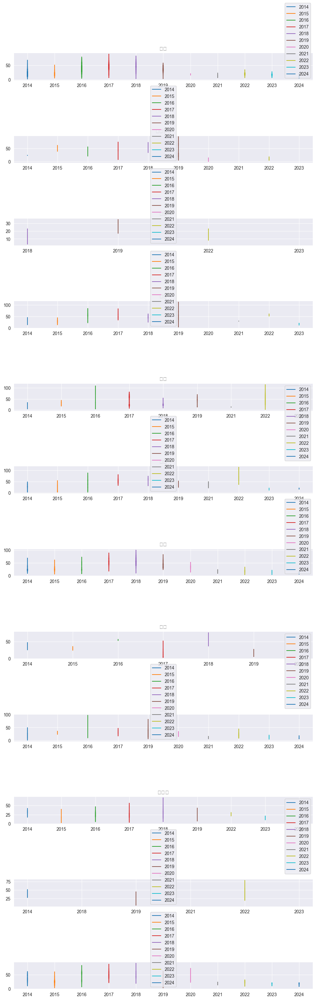

In [281]:
import matplotlib.pyplot as plt

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(10, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 라인 그래프 생성
        axs[i].plot(data['년도폴더'], data['사진수'], label=year)
        axs[i].set_title(folder)
        axs[i].legend()

# 그래프 표시
plt.tight_layout()
plt.show()


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 44592 (\N{HANGUL SYLLABLE GI}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 53440 (\N{HANGUL SYLLABLE TA}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4358 (\N{HANGUL CHOSEONG MIEUM}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4462 (\N{HANGUL JUNGSEONG U}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarning: Glyph 4355 (\N{HANGUL CHOSEONG TIKEUT}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3066285259.py:24: UserWarn

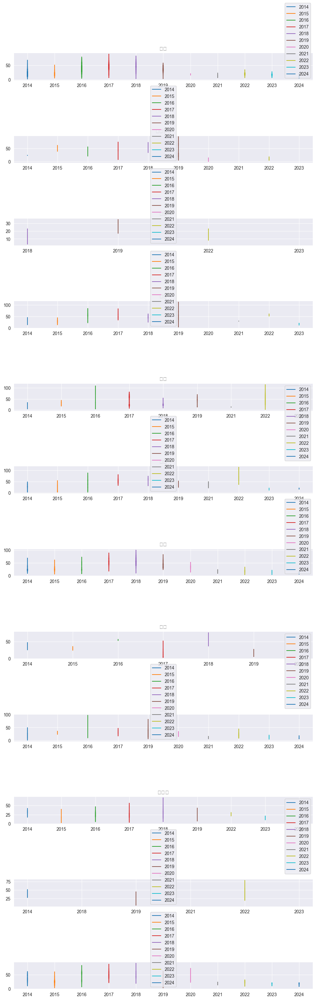

In [282]:
import matplotlib.pyplot as plt

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(10, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 라인 그래프 생성
        axs[i].plot(data['년도폴더'], data['사진수'], label=year)
        axs[i].set_title(folder)
        axs[i].legend()

# 그래프 표시
plt.tight_layout()
plt.show()


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: Glyph 44592 (\N{HANGUL SYLLABLE GI}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: Glyph 53440 (\N{HANGUL SYLLABLE TA}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: Glyph 4358 (\N{HANGUL CHOSEONG MIEUM}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: Glyph 4462 (\N{HANGUL JUNGSEONG U}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: Glyph 4355 (\N{HANGUL CHOSEONG TIKEUT}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/243215983.py:24: UserWarning: G

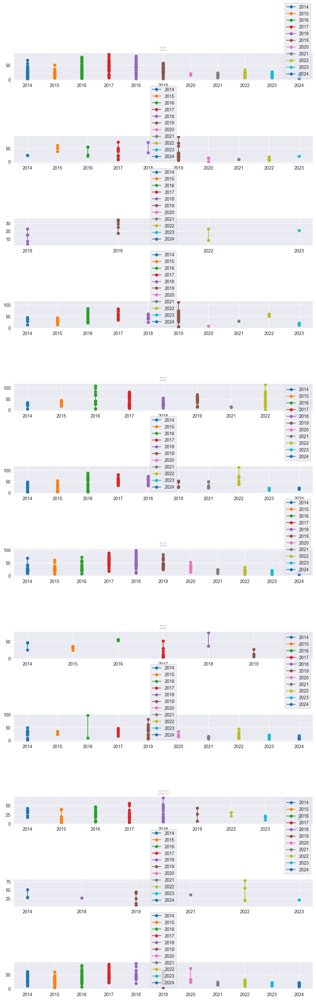

In [283]:
import matplotlib.pyplot as plt

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(10, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 라인 그래프 생성
        axs[i].plot(data['년도폴더'], data['사진수'], label=year, marker='o')
        axs[i].set_title(folder)
        axs[i].legend()

# 그래프 표시
plt.tight_layout()
plt.show()


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWarning: Glyph 45380 (\N{HANGUL SYLLABLE NYEON}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWarning: Glyph 46020 (\N{HANGUL SYLLABLE DO}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWarning: Glyph 54260 (\N{HANGUL SYLLABLE POL}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWarning: Glyph 45908 (\N{HANGUL SYLLABLE DEO}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWarning: Glyph 49324 (\N{HANGUL SYLLABLE SA}) missing from current font.
  plt.tight_layout()
/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/3106388731.py:25: UserWar

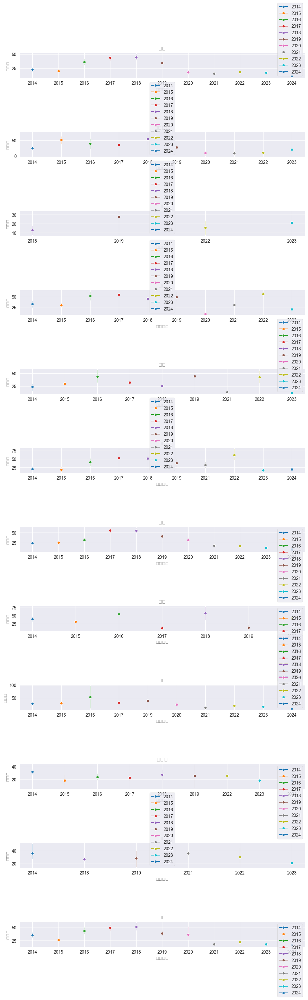

In [285]:
import seaborn as sns
import matplotlib.pyplot as plt

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(10, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 라인 그래프 생성
        sns.lineplot(data=data, x='년도폴더', y='사진수', ax=axs[i], label=year, marker='o')
        axs[i].set_title(folder)
        # axs[i].legend()

# 그래프 표시
plt.tight_layout()
plt.show()


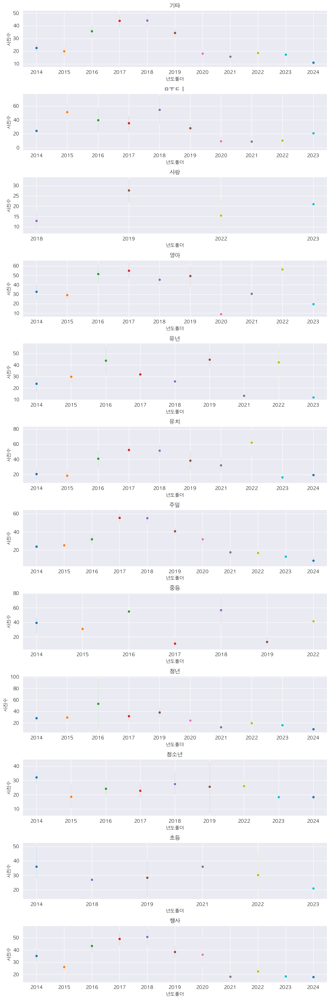

In [286]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(10, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 라인 그래프 생성
        sns.lineplot(data=data, x='년도폴더', y='사진수', ax=axs[i], label=year, marker='o', legend=False)
        axs[i].set_title(folder)

# 그래프 표시
plt.tight_layout()
plt.show()


In [289]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 그래프 사이즈 설정
plt.figure(figsize=(25, 15))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 바 그래프 생성
        sns.barplot(data=data, x='년도폴더', y='사진수', ax=axs[i], color='skyblue', alpha=0.7)
        axs[i].set_title(folder)

# 그래프 표시
plt.tight_layout()
plt.show()


<Figure size 2500x1500 with 0 Axes>

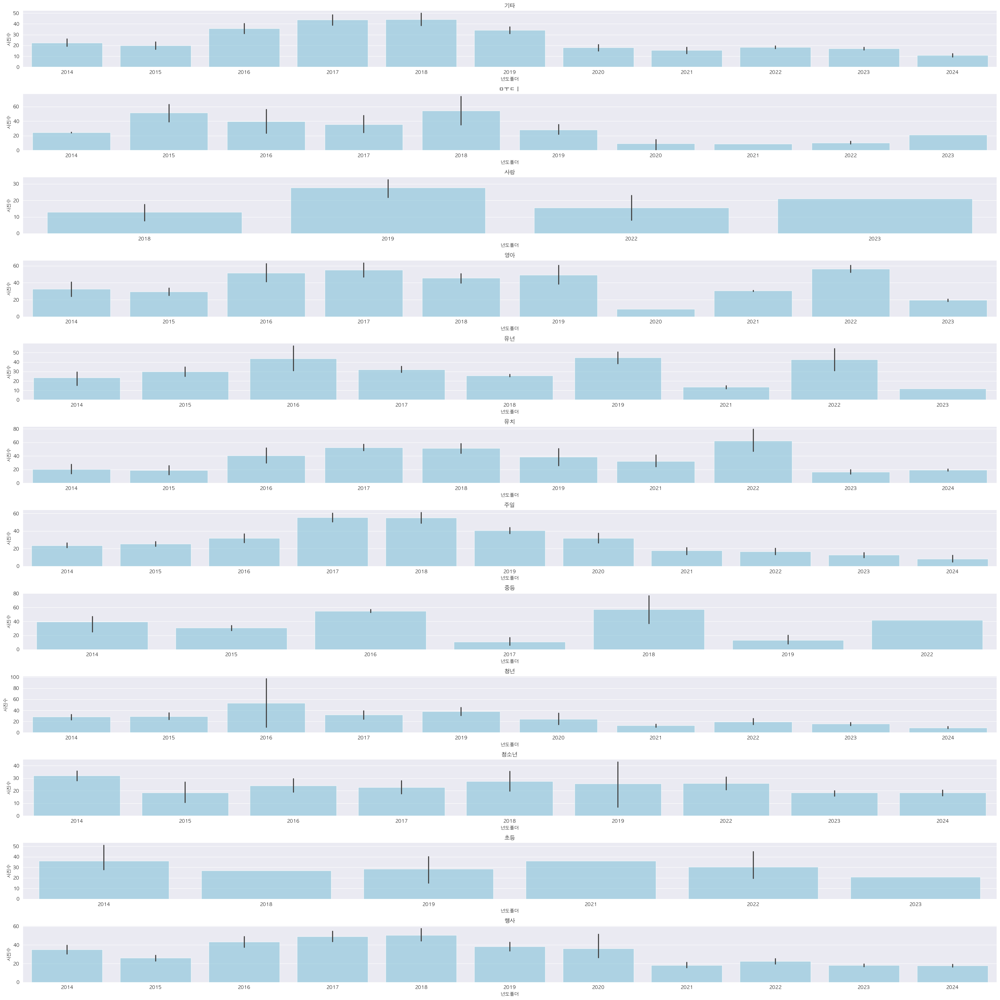

In [291]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 서브플롯 생성
fig, axs = plt.subplots(len(group_list[0]), figsize=(30, 30))

# 각 상위폴더별로 반복하여 그래프 생성
for i, folder in enumerate(group_list[0]):
    for j, year in enumerate(group_list[1]):
        # 해당 상위폴더와 년도 폴더에 해당하는 데이터 필터링
        data = folder_df[(folder_df['상위폴더'] == folder) & (folder_df['년도폴더'] == year)]
        
        # 바 그래프 생성
        sns.barplot(data=data, x='년도폴더', y='사진수', ax=axs[i], color='skyblue', alpha=0.7)
        axs[i].set_title(folder)

# 그래프 표시
plt.tight_layout()
plt.show()


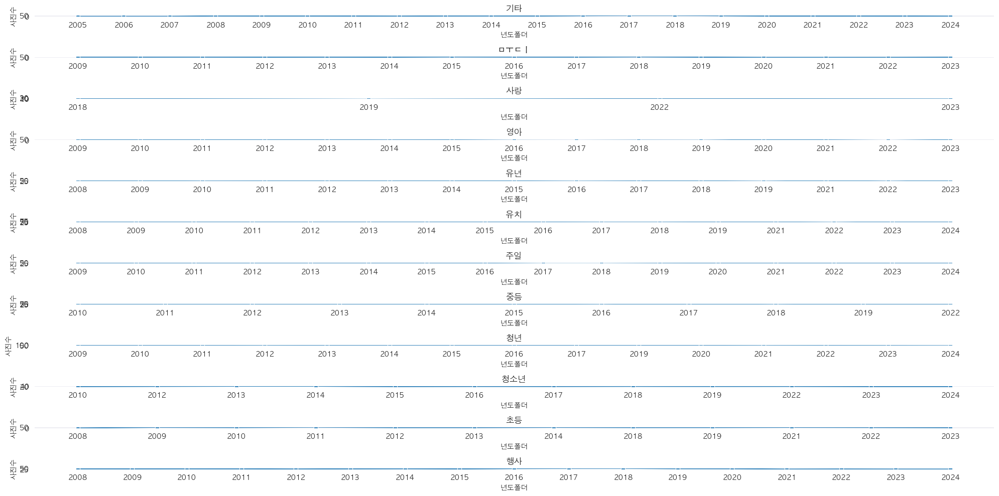

In [292]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 그래프 사이즈 설정
plt.figure(figsize=(20, 10))

# 각 상위폴더별로 반복하여 그래프 생성
for folder in group_list[0]:
    # 서브플롯 생성
    plt.subplot(len(group_list[0]), 1, group_list[0].index(folder) + 1)
    
    # 해당 상위폴더에 해당하는 데이터 필터링
    data = folder_df[folder_df['상위폴더'] == folder]
    
    # 라인 그래프 생성
    sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', legend=False)
    plt.title(folder)

# 그래프 표시
plt.tight_layout()
plt.show()


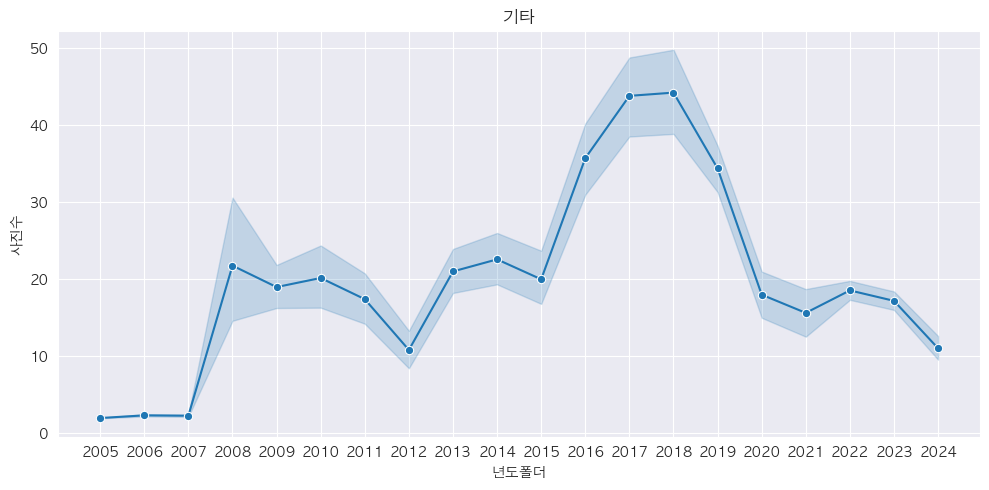

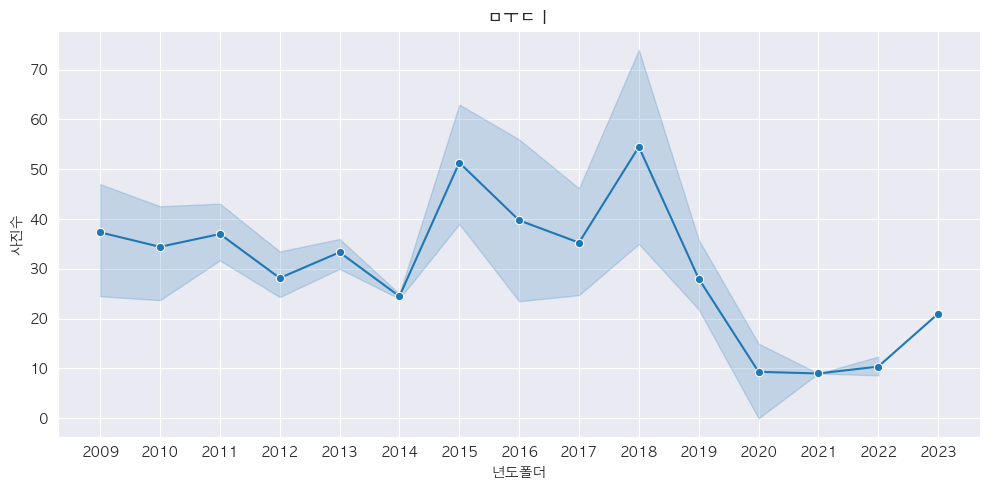

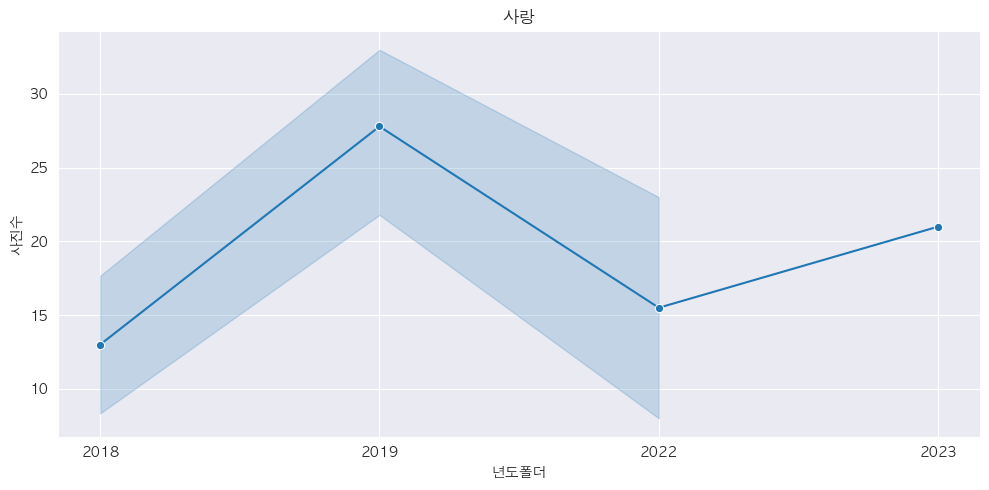

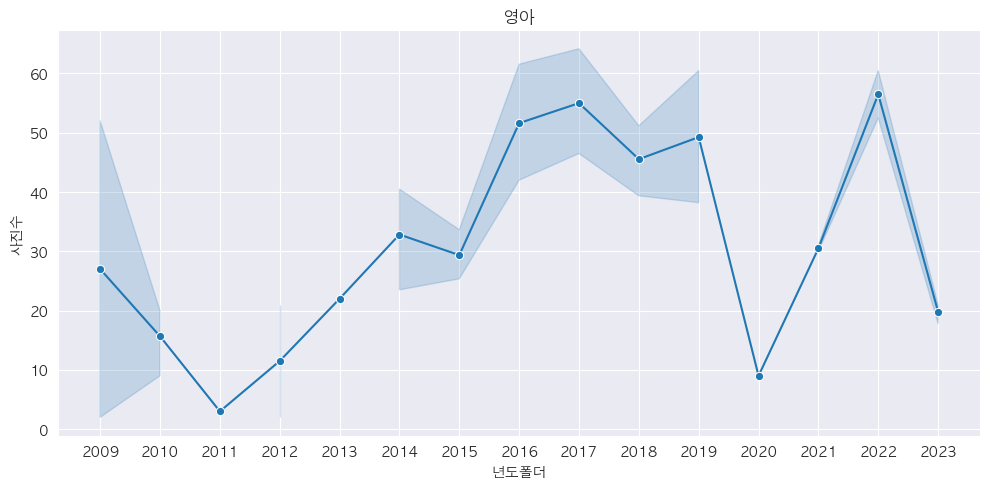

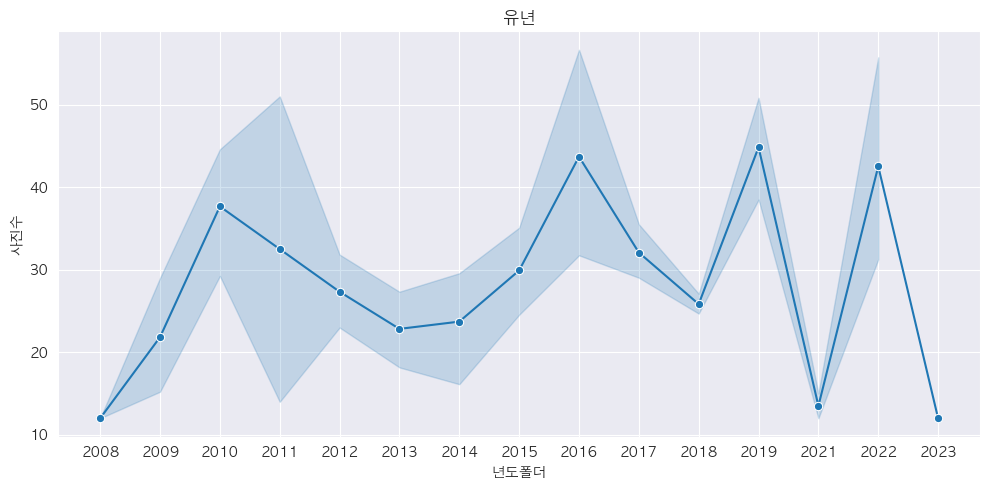

...

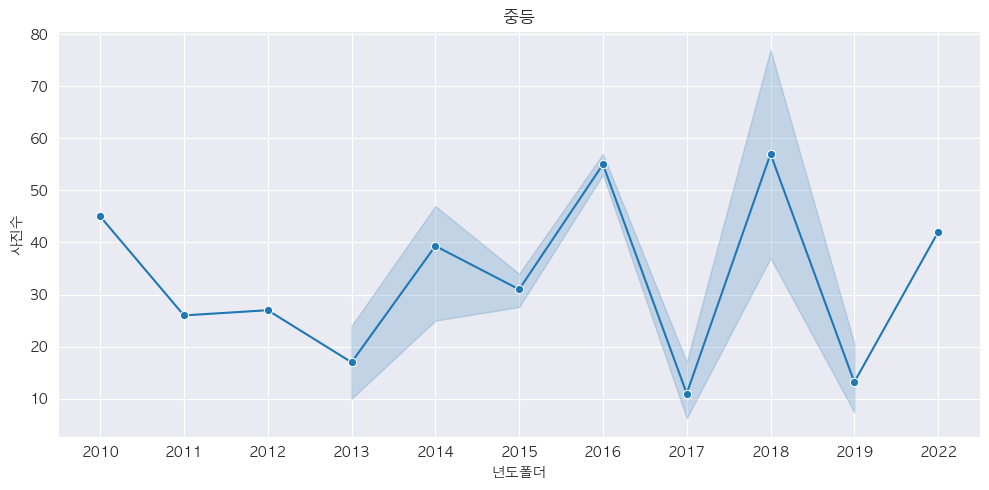

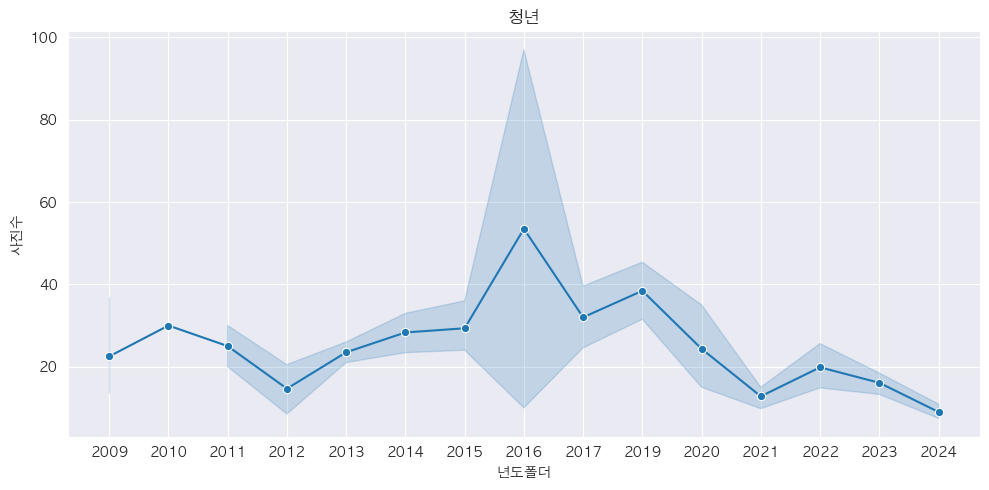

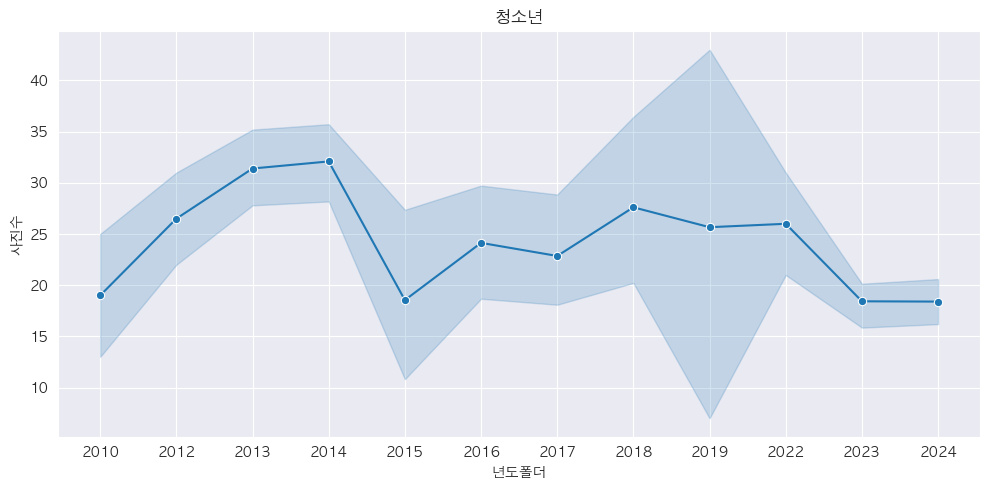

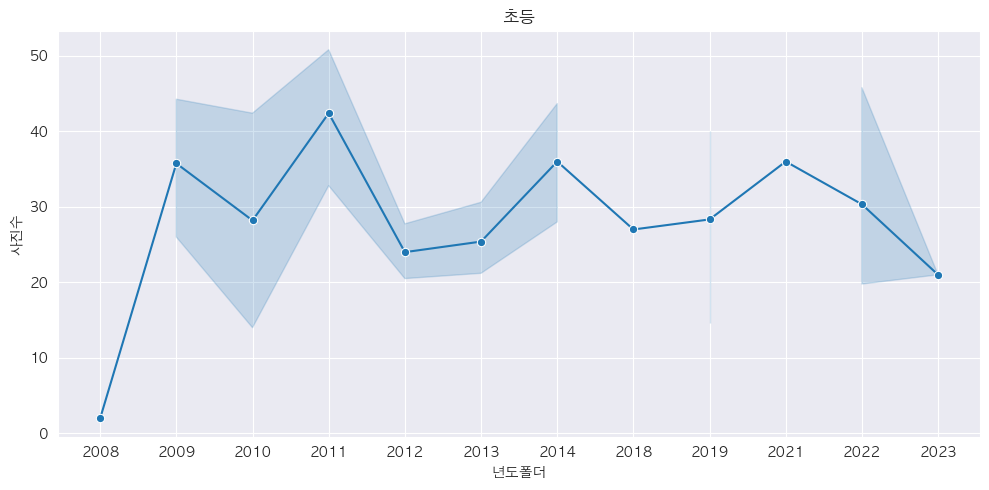

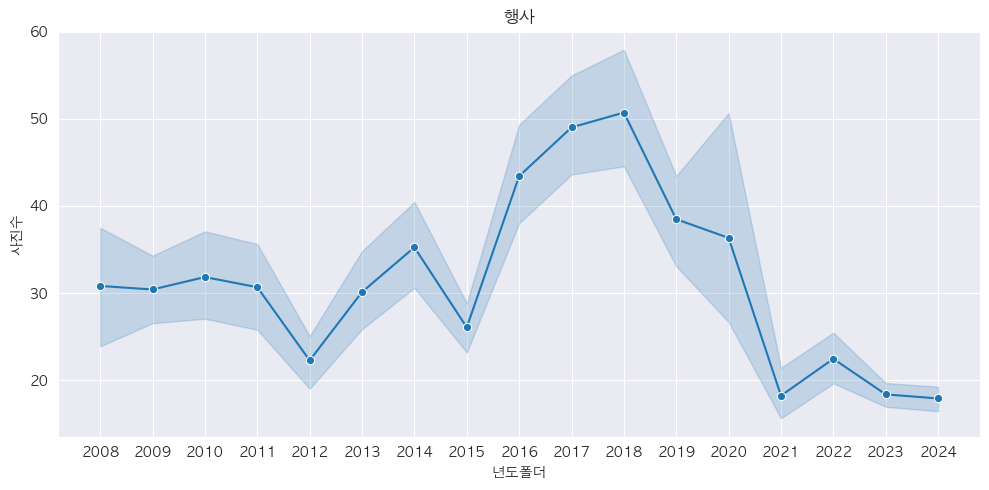

In [293]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 각 상위폴더별로 반복하여 그래프 생성
for folder in group_list[0]:
    # 그래프 사이즈 설정
    plt.figure(figsize=(10, 5))
    
    # 해당 상위폴더에 해당하는 데이터 필터링
    data = folder_df[folder_df['상위폴더'] == folder]
    
    # 라인 그래프 생성
    sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o')
    plt.title(folder)
    
    # 그래프 표시
    plt.tight_layout()
    plt.show()


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


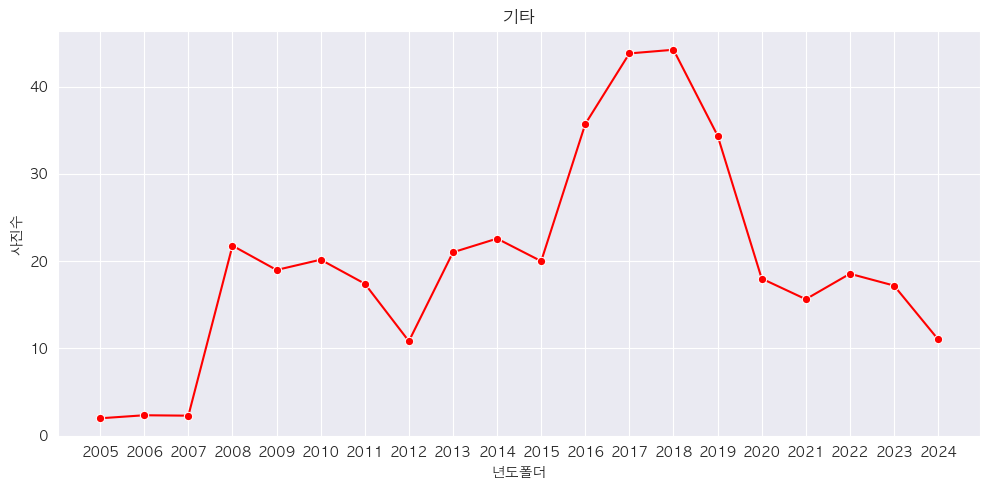

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


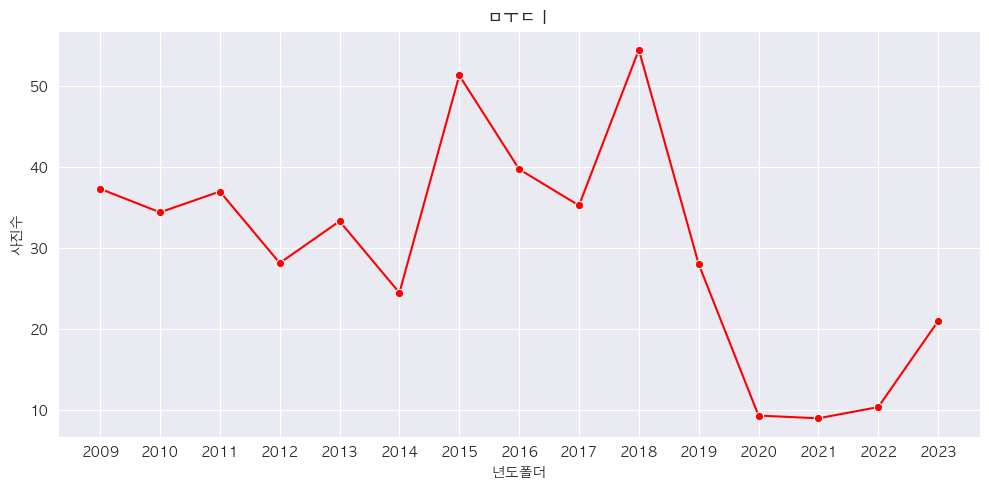

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


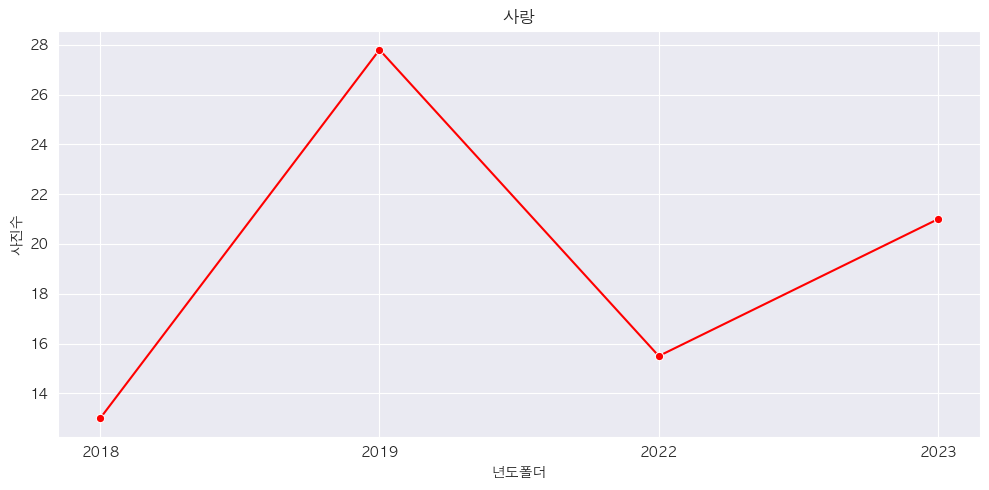

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


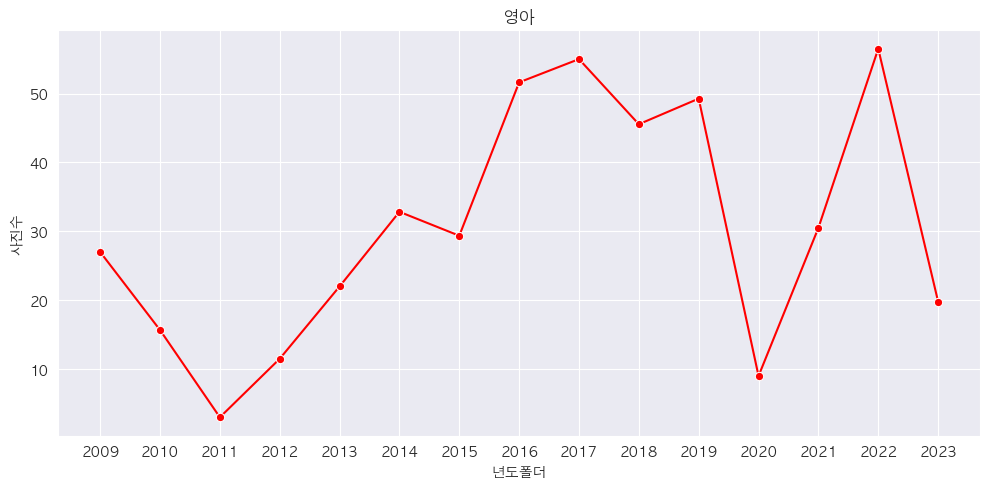

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


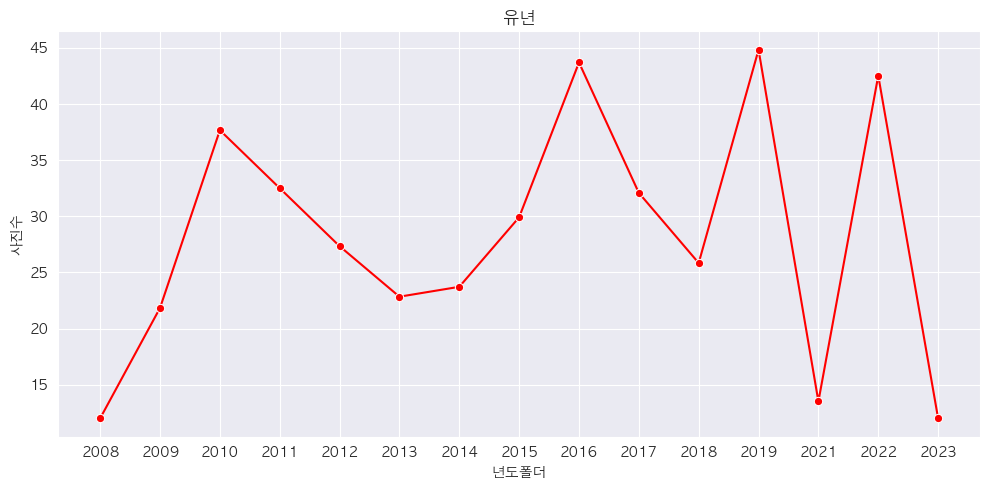

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


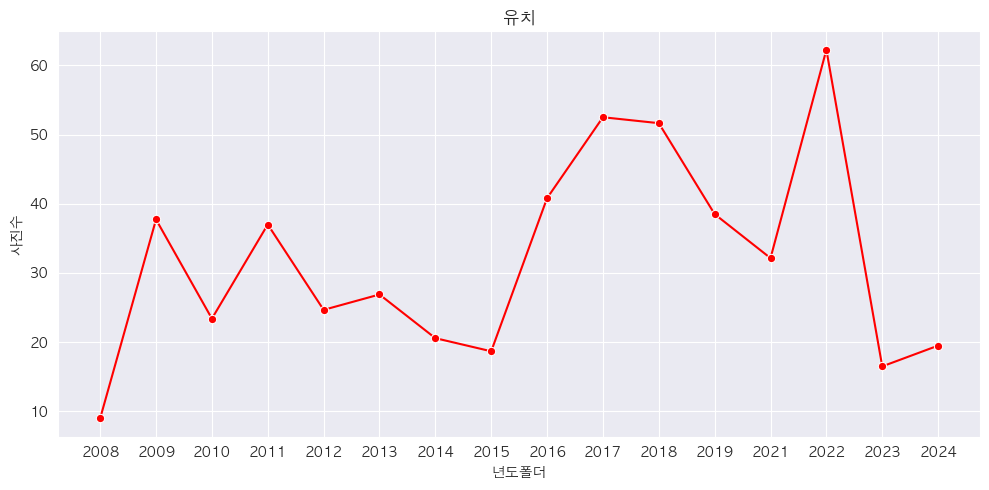

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


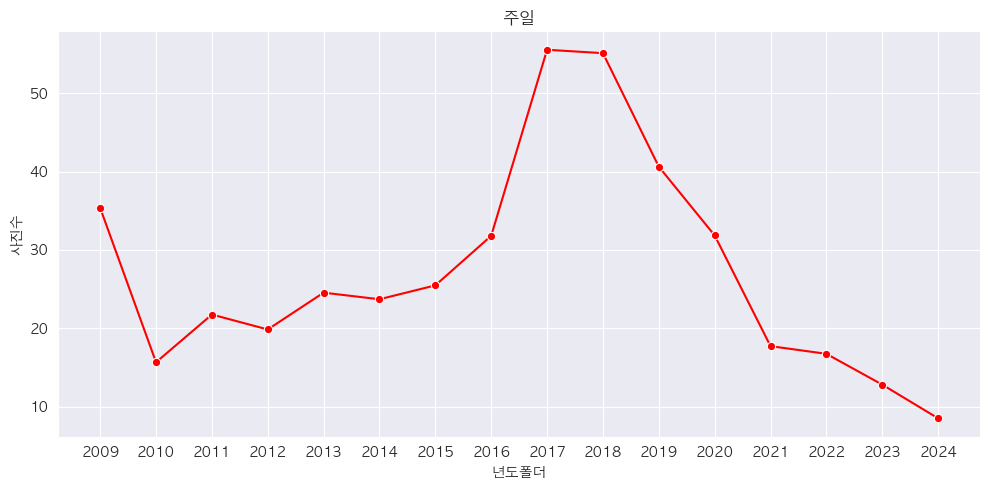

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


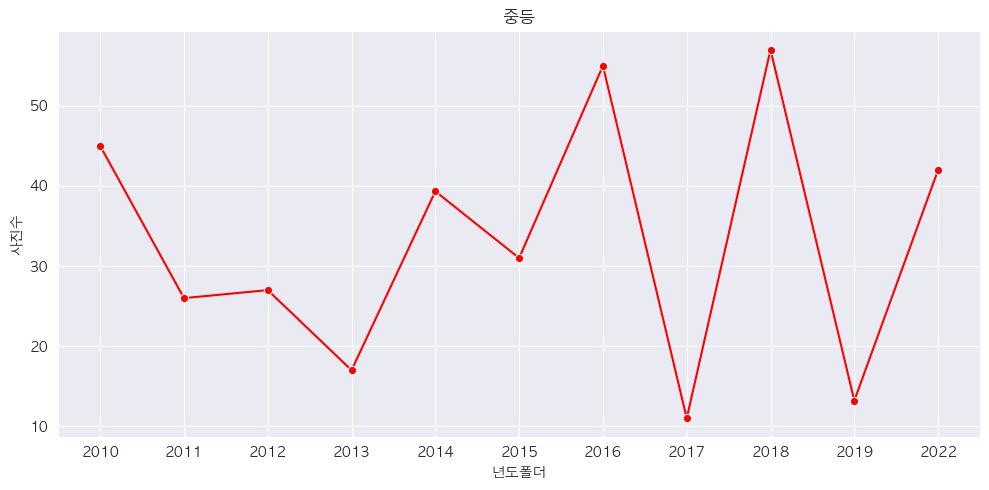

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


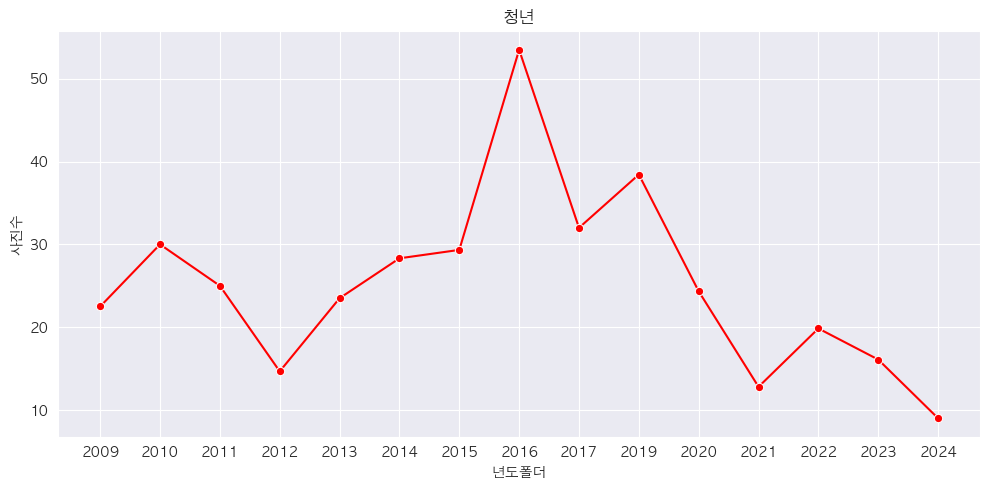

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


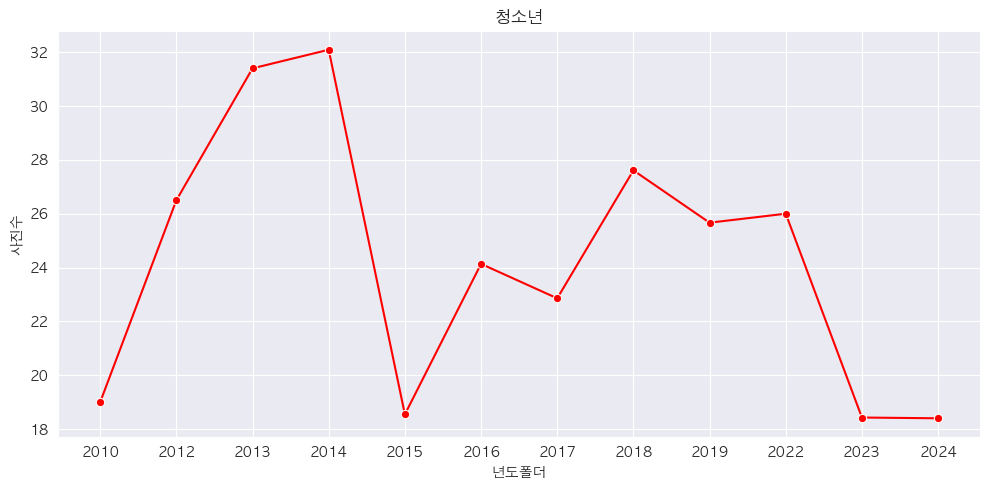

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


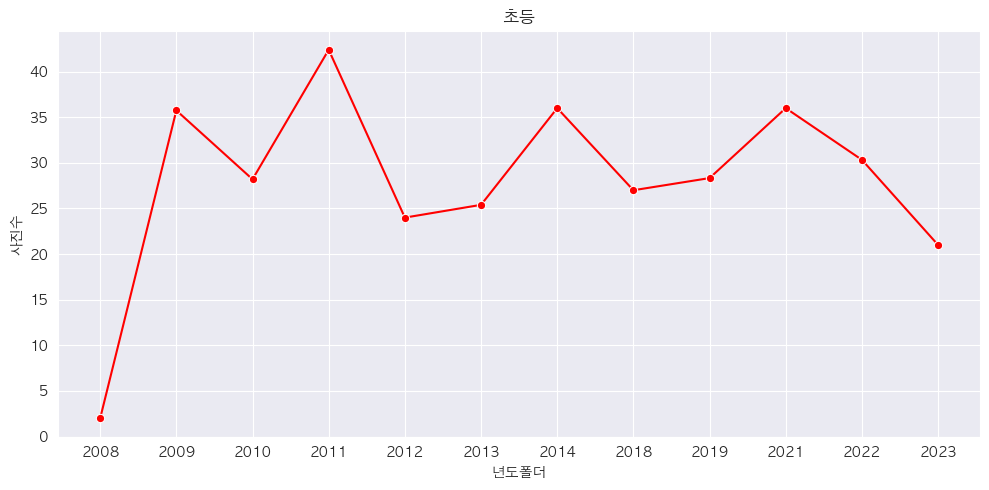

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


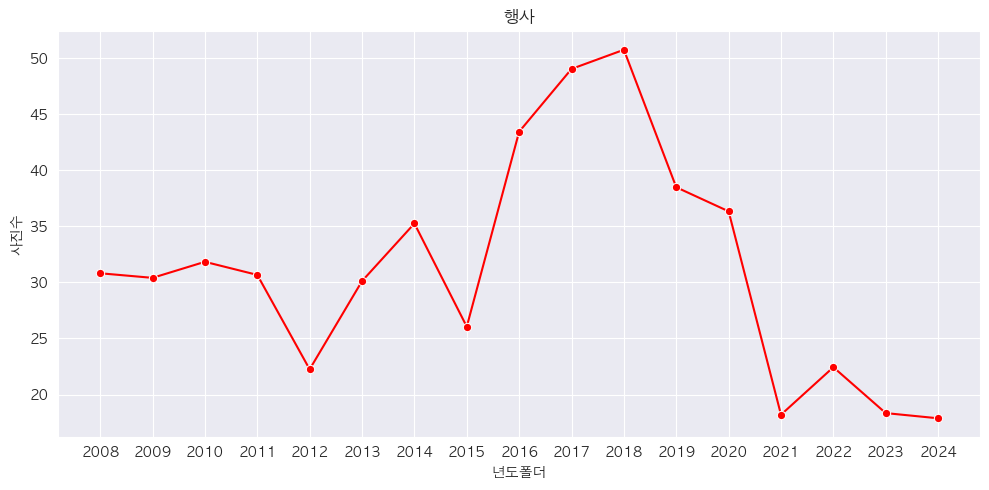

In [294]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 각 상위폴더별로 반복하여 그래프 생성
for folder in group_list[0]:
    # 그래프 사이즈 설정
    plt.figure(figsize=(10, 5))
    
    # 해당 상위폴더에 해당하는 데이터 필터링
    data = folder_df[folder_df['상위폴더'] == folder]
    
    # 라인 그래프 생성
    sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)
    plt.title(folder)
    
    # 그래프 표시
    plt.tight_layout()
    plt.show()


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


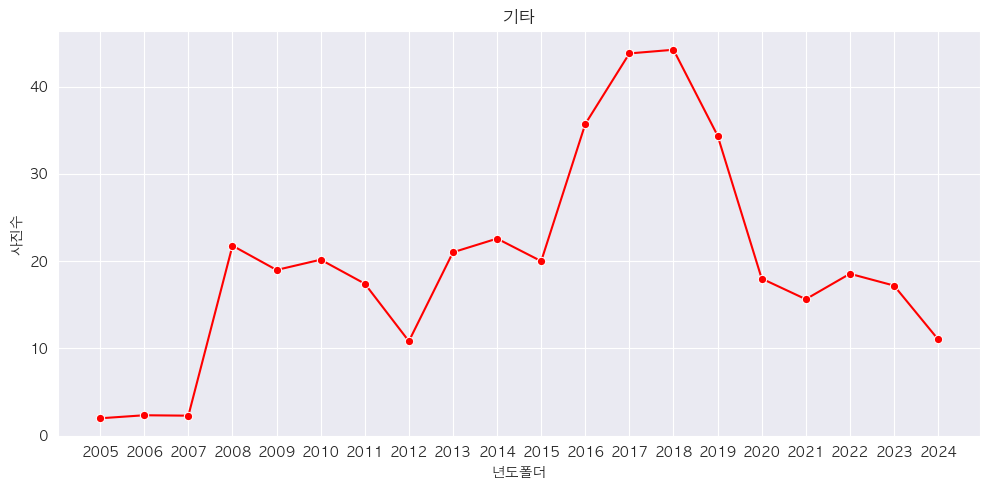

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


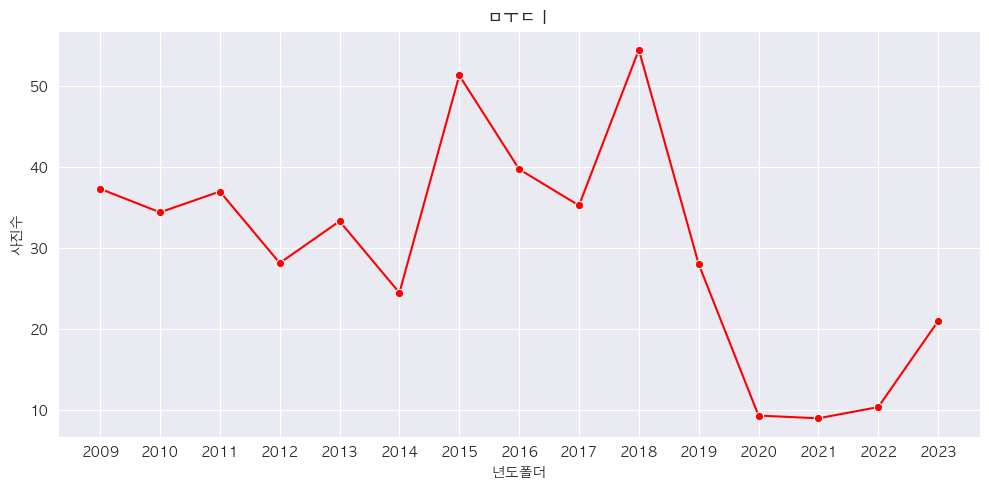

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


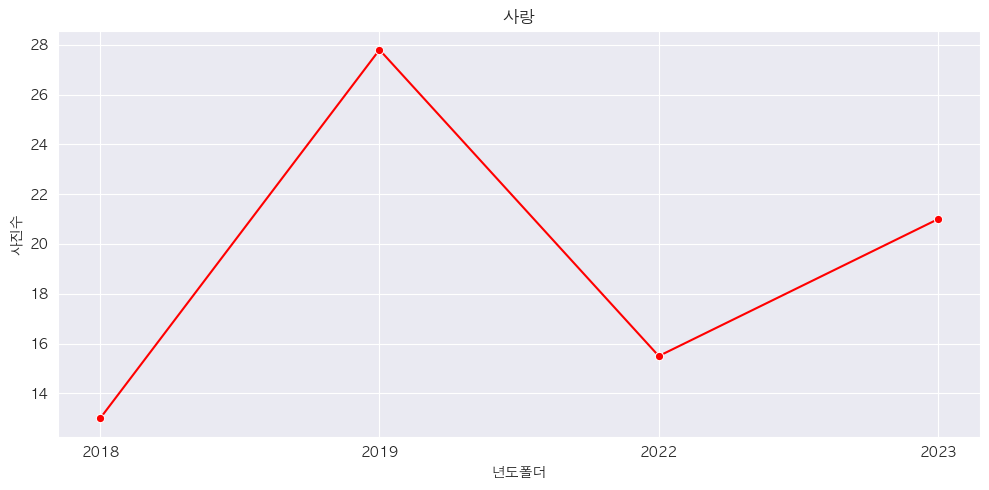

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


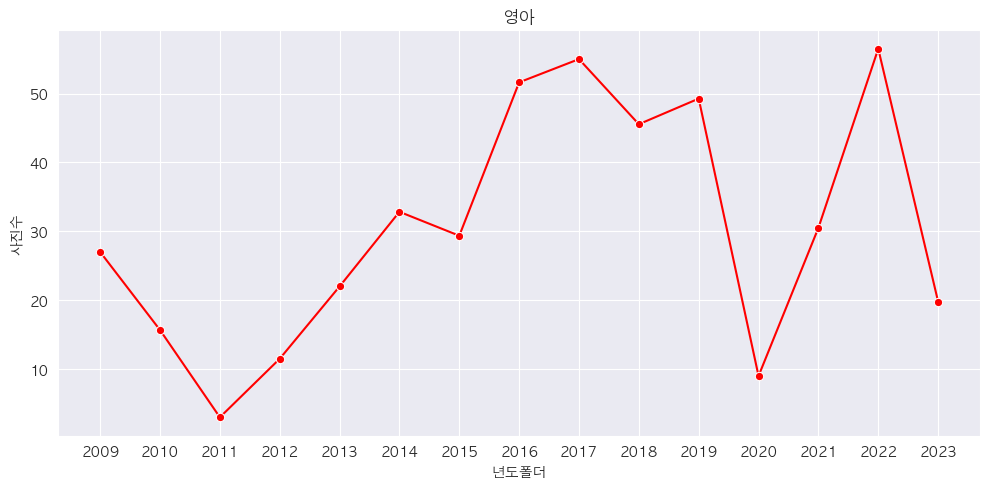

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


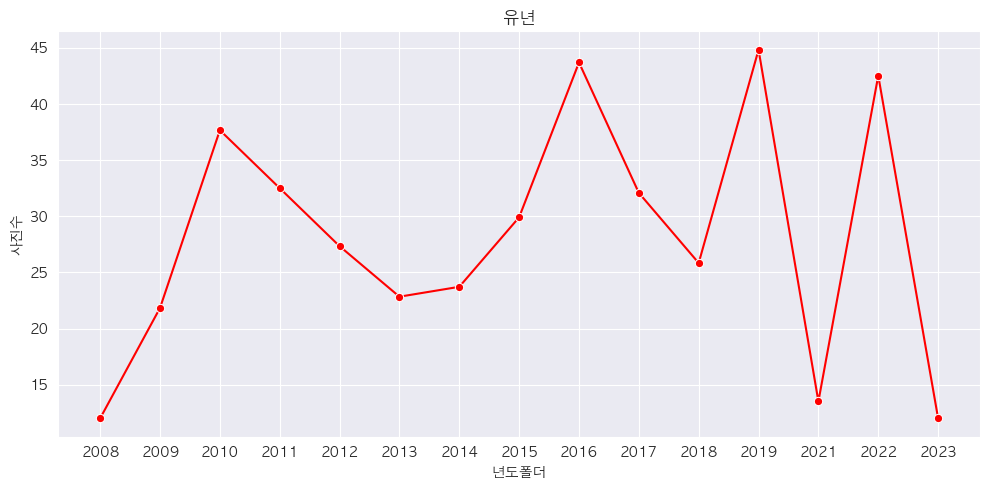

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


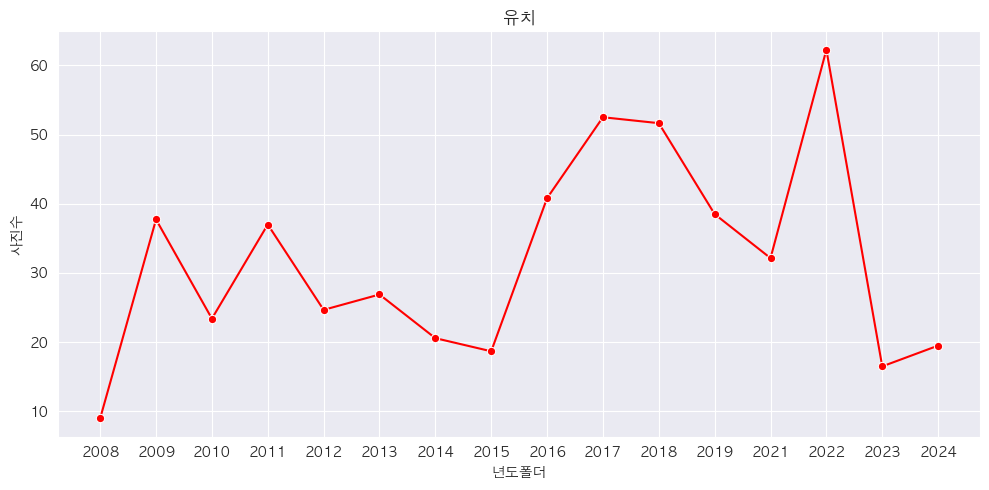

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


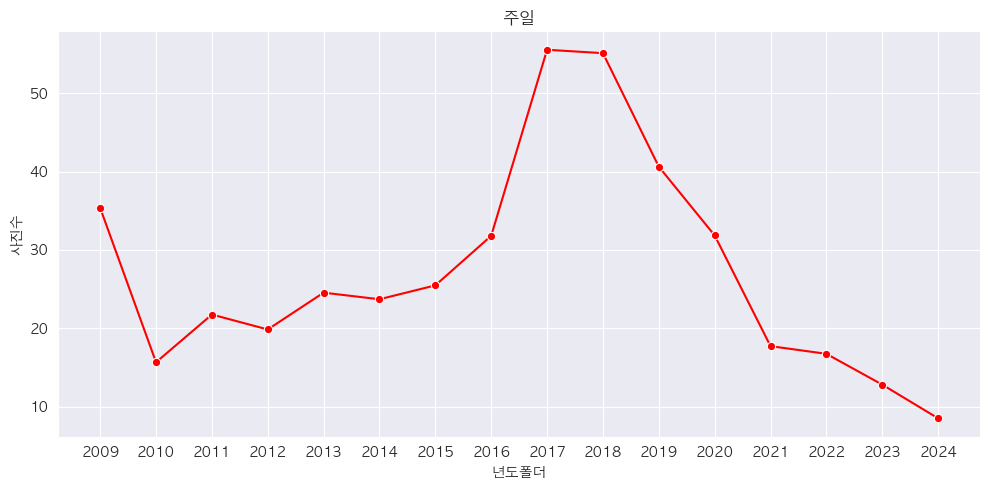

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


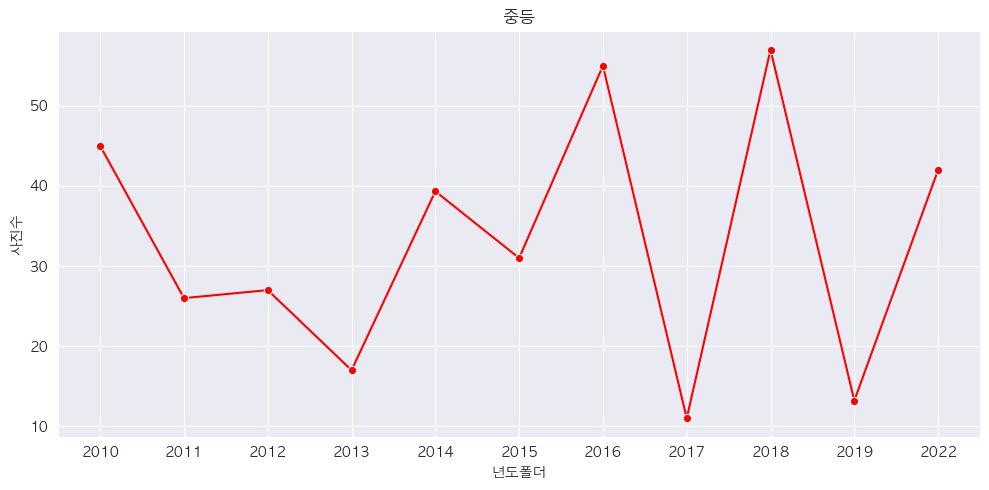

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


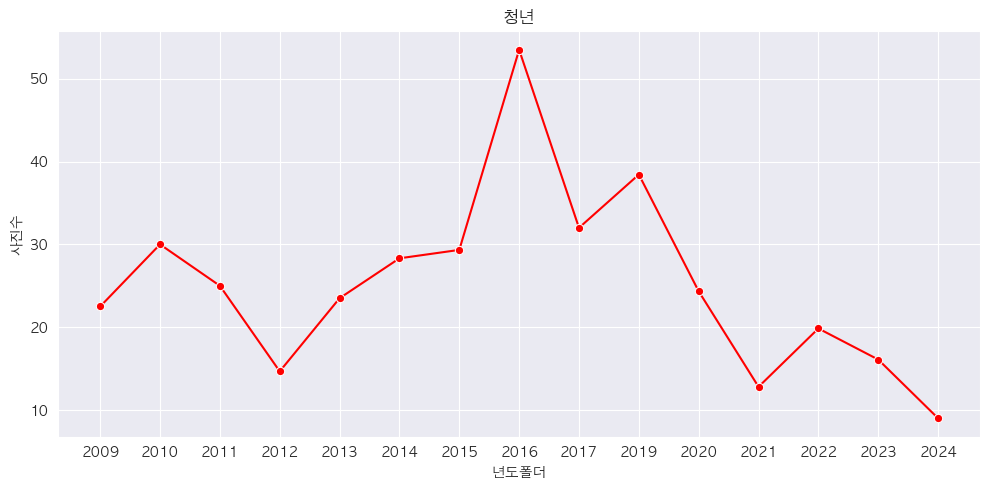

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


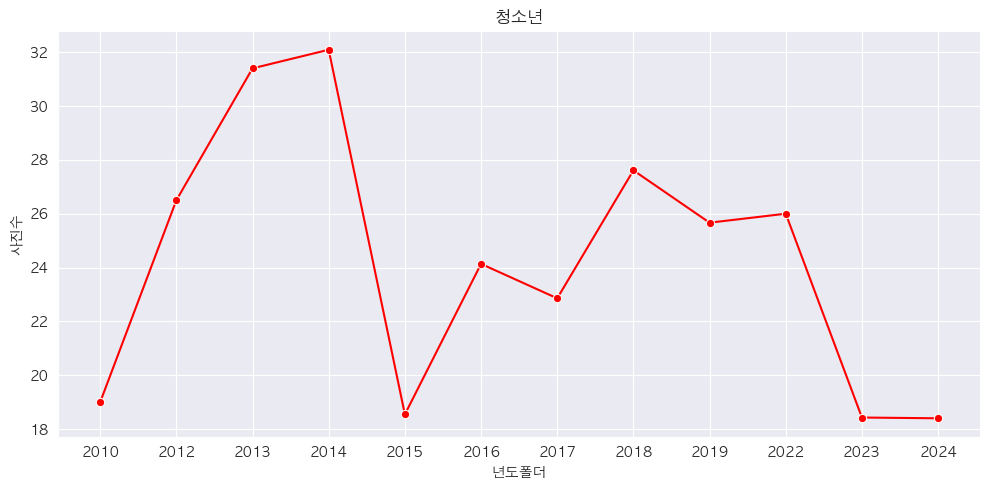

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


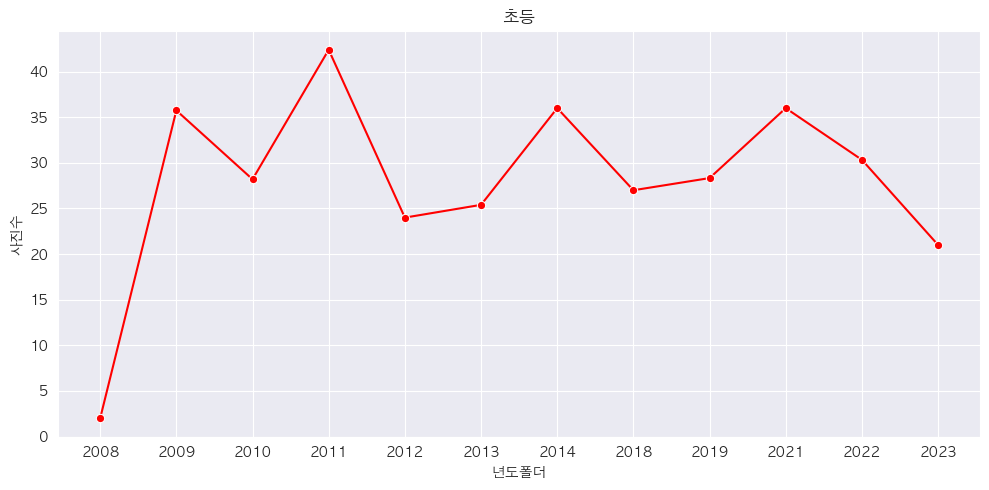

/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/1750356730.py:22: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)


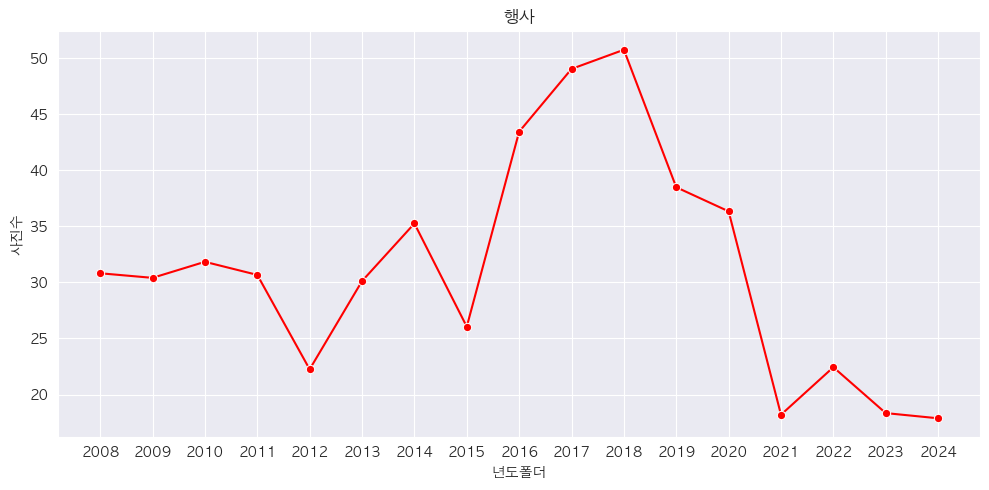

In [295]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 각 상위폴더별로 반복하여 그래프 생성
for folder in group_list[0]:
    # 그래프 사이즈 설정
    plt.figure(figsize=(10, 5))
    
    # 해당 상위폴더에 해당하는 데이터 필터링
    data = folder_df[folder_df['상위폴더'] == folder]
    
    # 라인 그래프 생성
    sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', ci=None)
    plt.title(folder)
    
    # 그래프 표시
    plt.tight_layout()
    plt.show()


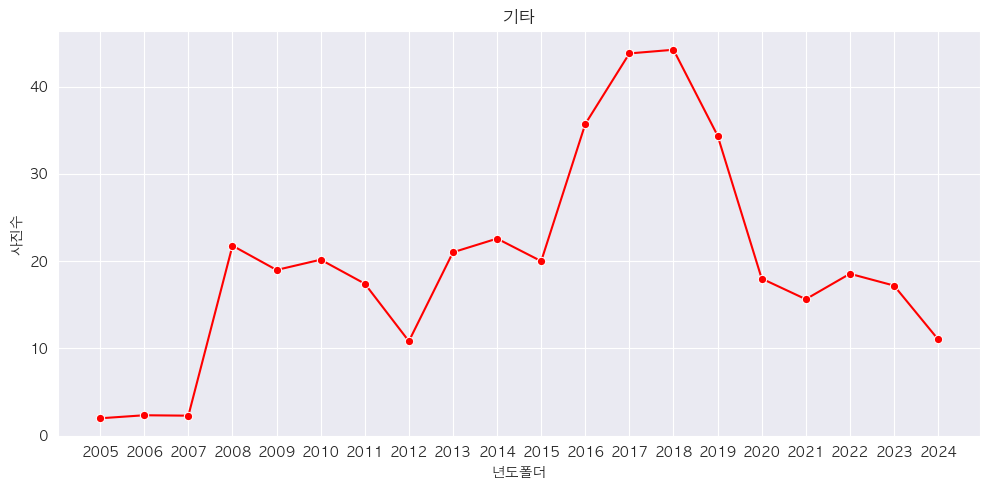

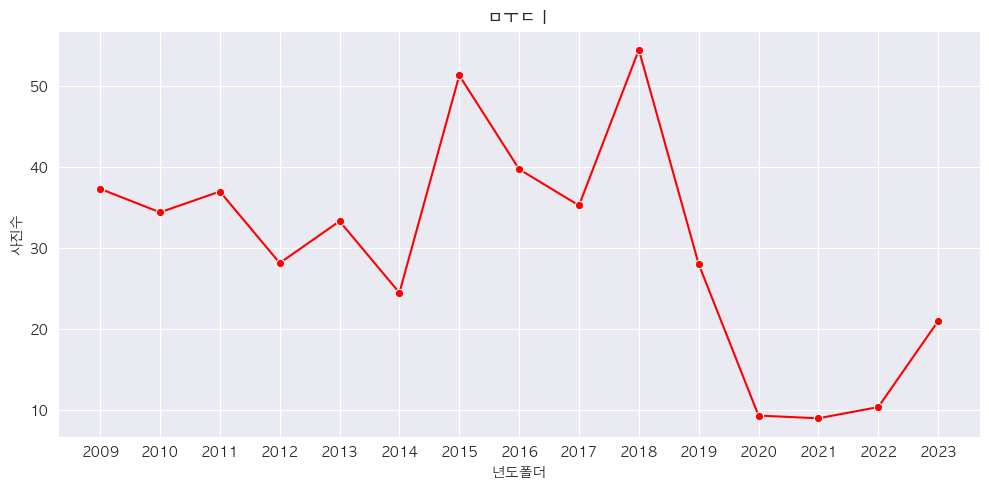

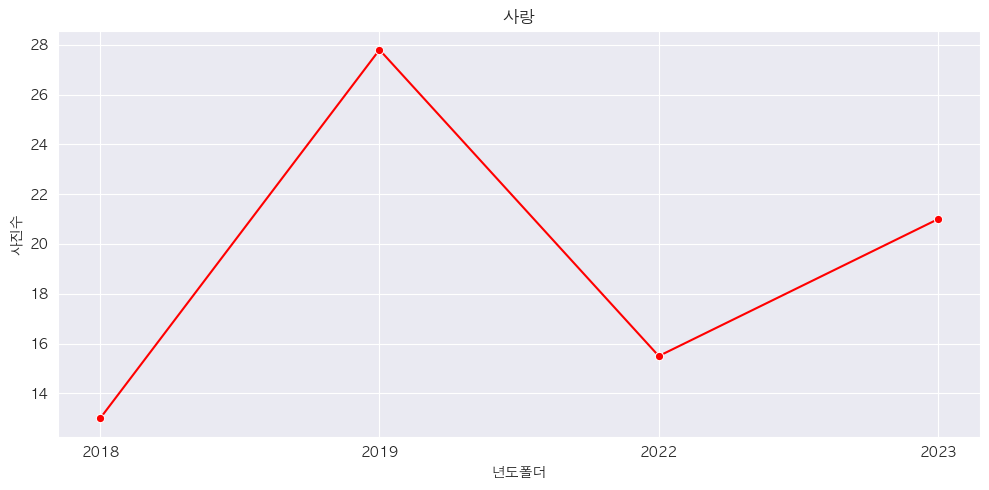

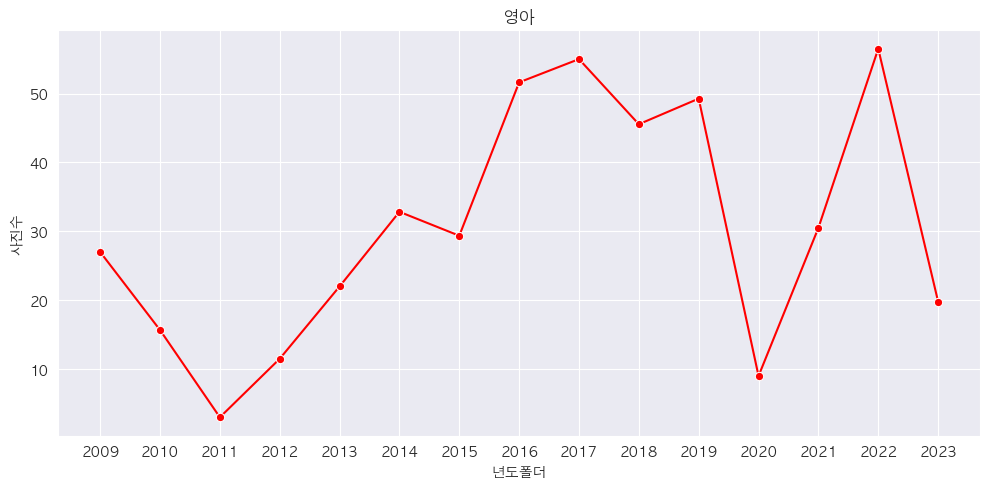

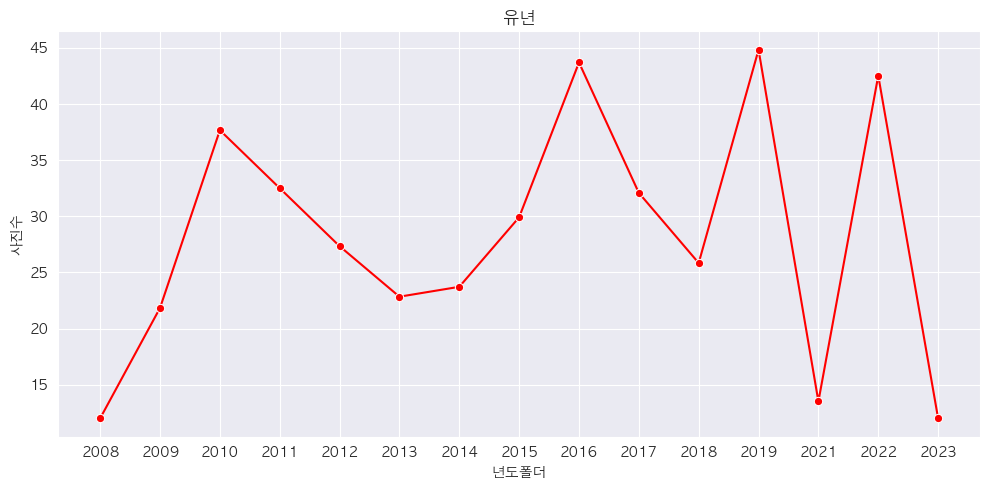

...

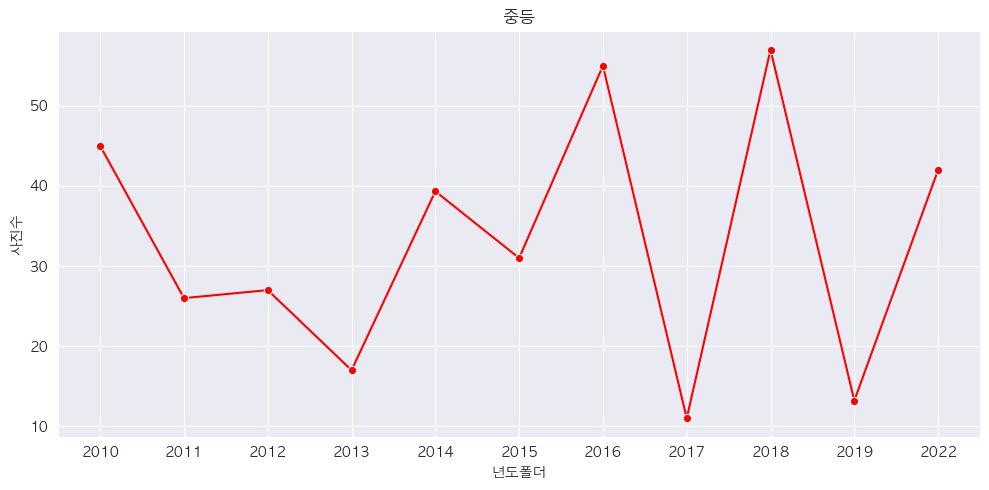

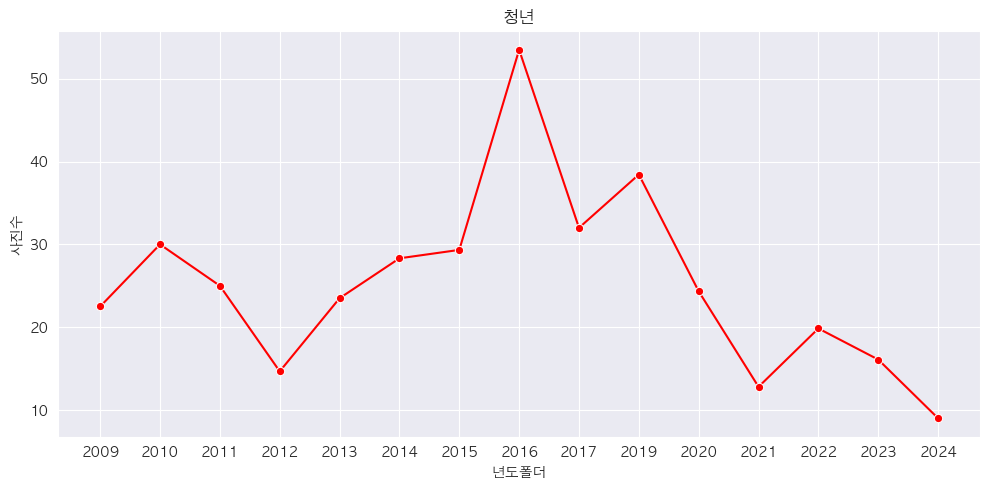

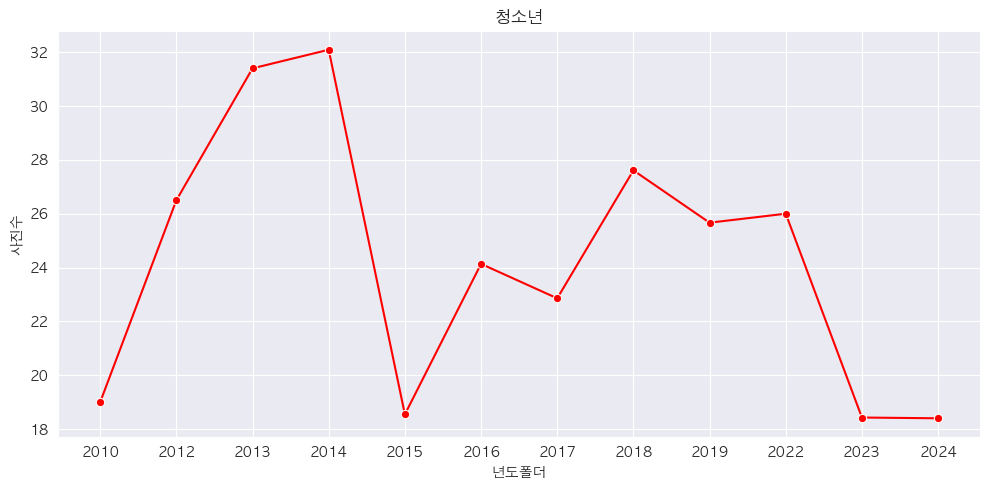

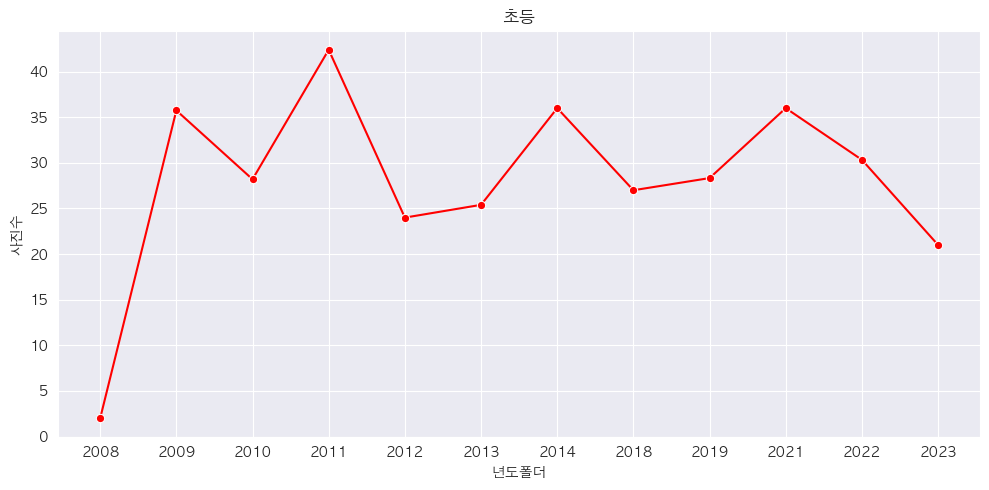

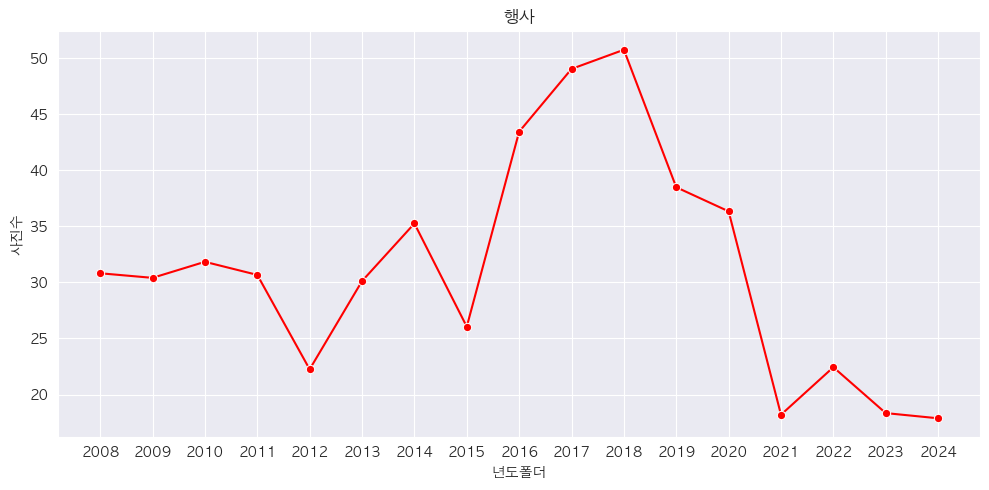

In [296]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 그래프를 그리기 위한 데이터프레임 준비
group_list = [
    ['기타', '무디', '사랑', '영아', '유년', '유치', '주일', '중등', '청년', '청소년', '초등', '행사'],
    ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
]

# 각 상위폴더별로 반복하여 그래프 생성
for folder in group_list[0]:
    # 그래프 사이즈 설정
    plt.figure(figsize=(10, 5))
    
    # 해당 상위폴더에 해당하는 데이터 필터링
    data = folder_df[folder_df['상위폴더'] == folder]
    
    # 라인 그래프 생성
    sns.lineplot(data=data, x='년도폴더', y='사진수', marker='o', color='red', errorbar=None)
    plt.title(folder)
    
    # 그래프 표시
    plt.tight_layout()
    plt.show()


In [297]:
folder_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3157 entries, 0 to 3156
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   상위폴더    3157 non-null   category
 1   년도폴더    3157 non-null   object  
 2   제목      3157 non-null   object  
 3   사진수     3157 non-null   int64   
 4   용량      3157 non-null   int64   
 5   등록일     3157 non-null   object  
dtypes: category(1), int64(2), object(3)
memory usage: 126.9+ KB


/var/folders/72/kw4jxtc54k77pfy0tcqk7y1m0000gn/T/ipykernel_37999/2229891423.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  photo_count_by_folder = folder_df.groupby('상위폴더')['사진수'].sum().reset_index()


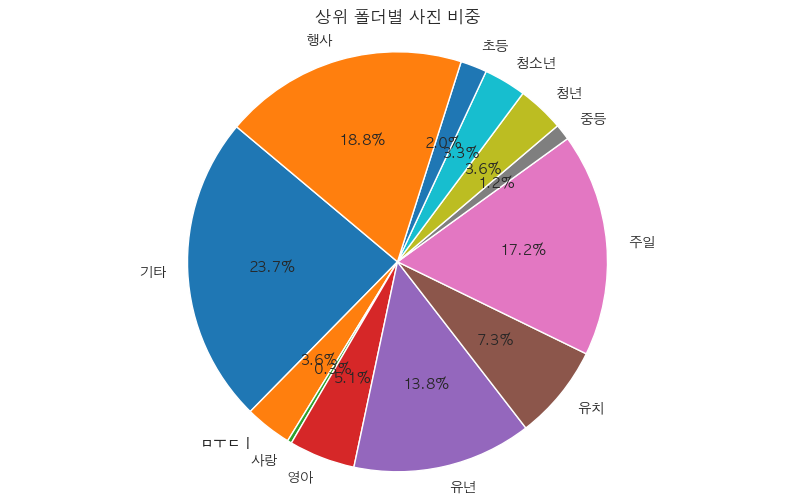

In [298]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 상위 폴더별 사진 수 집계
photo_count_by_folder = folder_df.groupby('상위폴더')['사진수'].sum().reset_index()

# 원형 그래프 그리기
plt.figure(figsize=(10, 6))
plt.pie(photo_count_by_folder['사진수'], labels=photo_count_by_folder['상위폴더'], autopct='%1.1f%%', startangle=140)
plt.title('상위 폴더별 사진 비중')
plt.axis('equal')  # 원형 그래프를 원으로 유지하기 위해 설정
plt.show()


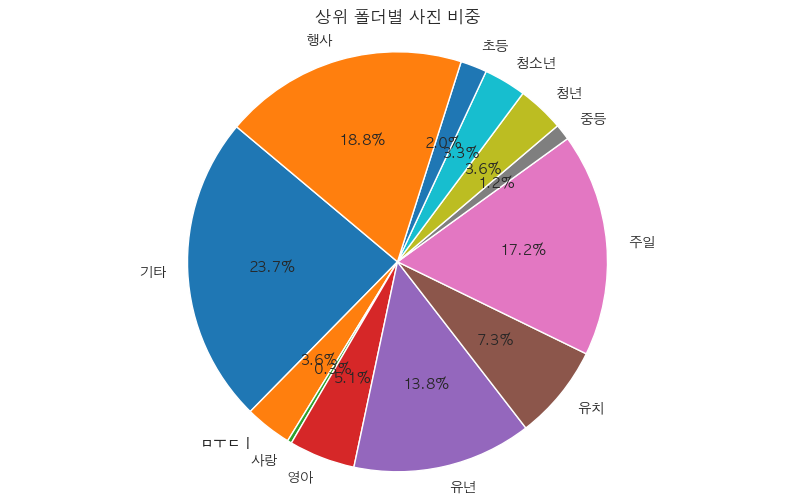

In [299]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 상위 폴더별 사진 수 집계
photo_count_by_folder = folder_df.groupby('상위폴더', observed=False)['사진수'].sum().reset_index()

# 원형 그래프 그리기
plt.figure(figsize=(10, 6))
plt.pie(photo_count_by_folder['사진수'], labels=photo_count_by_folder['상위폴더'], autopct='%1.1f%%', startangle=140)
plt.title('상위 폴더별 사진 비중')
plt.axis('equal')  # 원형 그래프를 원으로 유지하기 위해 설정
plt.show()


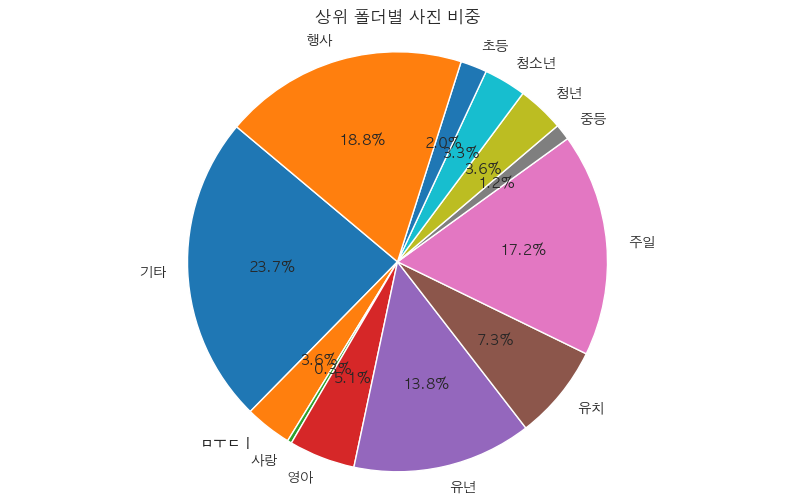

In [300]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 상위 폴더별 사진 수 집계
photo_count_by_folder = folder_df.groupby('상위폴더', observed=False)['사진수'].sum().reset_index()

# 원형 그래프 그리기
plt.figure(figsize=(10, 6))
plt.pie(photo_count_by_folder['사진수'], labels=photo_count_by_folder['상위폴더'], autopct='%1.1f%%', startangle=140)
plt.title('상위 폴더별 사진 비중')
plt.axis('equal')  # 원형 그래프를 원으로 유지하기 위해 설정
plt.show()


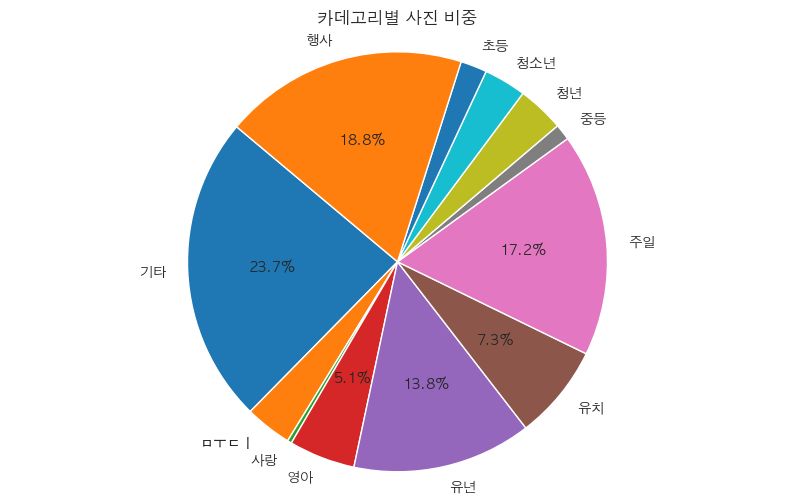

In [302]:
import seaborn as sns
import matplotlib.pyplot as plt

# 폰트 설정 변경
plt.rcParams['font.family'] = 'AppleGothic'

# 상위 폴더별 사진 수 집계
photo_count_by_folder = folder_df.groupby('상위폴더', observed=False)['사진수'].sum().reset_index()

# 원형 그래프 그리기
plt.figure(figsize=(10, 6))
plt.pie(photo_count_by_folder['사진수'], labels=photo_count_by_folder['상위폴더'], autopct=lambda p: '{:.1f}%'.format(p) if p > 5 else '', startangle=140)
plt.title('카데고리별 사진 비중')
plt.axis('equal')  # 원형 그래프를 원으로 유지하기 위해 설정
plt.show()


In [303]:
photo_count_by_folder 

,상위폴더,사진수
0,기타,19427
1,무디,2950
2,사랑,269
3,영아,4174
4,유년,11289
5,유치,5985
6,주일,14067
7,중등,1012
8,청년,2945
9,청소년,2663


In [316]:
photo_count_by_folder["비중"] = (photo_count_by_folder['사진수'] / photo_count_by_folder['사진수'].sum() *100).round(2)

In [318]:
photo_count_by_folder.to_clipboard()

In [319]:
photo_count_by_folder_year = folder_df.groupby('년도폴더', observed=False)['사진수'].sum().reset_index()

In [320]:
photo_count_by_folder_year

,년도폴더,사진수
0,2005,595
1,2006,100
2,2007,82
3,2008,920
4,2009,6167
5,2010,3156
6,2011,2724
7,2012,2519
8,2013,3759
9,2014,5625


<Axes: xlabel='사진수', ylabel='년도폴더'>

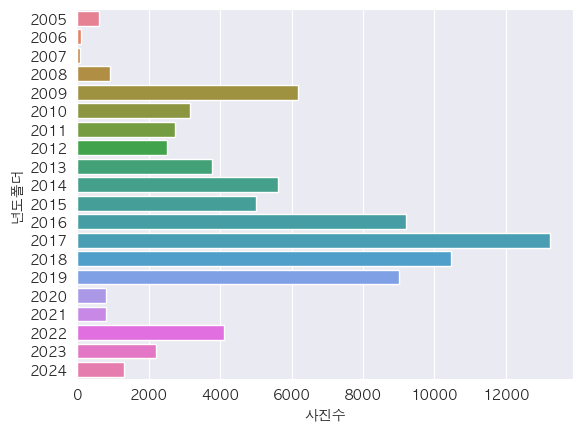

In [322]:
sns.barplot(photo_count_by_folder_year, y='년도폴더',x='사진수' ,hue='년도폴더' )

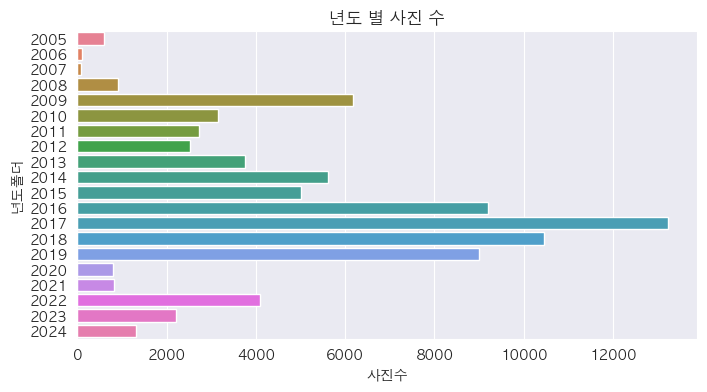

In [325]:
# 각 년도폴더별 사진 수 계산
photo_count_by_folder_year = folder_df.groupby('년도폴더', observed=False)['사진수'].sum().reset_index()

# 피규어 사이즈 설정
plt.figure(figsize=(8, 4))

# 그래프 그리기
sns.barplot(data=photo_count_by_folder_year, y='년도폴더', x='사진수', hue='년도폴더')

# 그래프 제목 추가
plt.title('년도 별 사진 수')

# 그래프 표시
plt.show()


In [327]:
import os
import pandas as pd

# 전체 파일 정보를 저장할 리스트
file_info_list = []

# 시작 디렉토리 경로
start_dir = '/Volumes/SEAGATE BAC'

# 디렉토리를 재귀적으로 탐색하고 파일 정보 수집하는 함수
def explore_directory(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            file_path = os.path.join(root, file)
            # 파일의 생성일, 수정일, 크기 가져오기
            created_time = os.path.getctime(file_path)
            modified_time = os.path.getmtime(file_path)
            size = os.path.getsize(file_path)
            # 파일 정보 리스트에 추가
            file_info_list.append({
                '파일경로': file_path,
                '파일명': file,
                '생성일': pd.to_datetime(created_time, unit='s'),
                '수정일': pd.to_datetime(modified_time, unit='s'),
                '크기': size
            })

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 파일 정보 리스트를 데이터프레임으로 변환
file_df = pd.DataFrame(file_info_list)

# 데이터프레임 출력
file_df


,파일경로,파일명,생성일,수정일,크기
0,/Volumes/SEAGATE BAC/._.Trashes,._.Trashes,2020-04-02 02:31:50.349999905,2020-04-02 02:31:50.349999905,4096
1,/Volumes/SEAGATE BAC/데코 사진1.hwp,데코 사진1.hwp,2024-03-05 06:05:36.000000000,2024-03-05 06:05:36.000000000,101009920
2,/Volumes/SEAGATE BAC/.fseventsd/fseventsd-uuid,fseventsd-uuid,2024-04-24 11:10:57.970000029,2024-04-24 11:10:57.970000029,36
3,/Volumes/SEAGATE BAC/System Volume Information...,WPSettings.dat,2020-04-02 02:32:26.000000000,2020-04-02 02:32:26.000000000,12
4,/Volumes/SEAGATE BAC/System Volume Information...,IndexerVolumeGuid,2020-04-02 02:32:26.000000000,2020-04-02 02:32:26.000000000,76
...,...,...,...,...,...
168641,/Volumes/SEAGATE BAC/50주년 데코/2011-2014/20...,2023 와락.jpeg,2024-03-05 08:30:14.000000000,2024-03-05 08:30:14.000000000,337225
168642,/Volumes/SEAGATE BAC/50주년 데코/2011-2014/20...,20230301 남자독립만세.JPG,2023-03-01 06:34:54.000000000,2023-03-01 06:34:54.000000000,4360209
168643,/Volumes/SEAGATE BAC/50주년 데코/2011-2014/20...,20230430 교회창립49주년 (2).JPG,2023-04-30 02:12:00.000000000,2023-04-30 02:12:00.000000000,4941429
168644,/Volumes/SEAGATE BAC/50주년 데코/2011-2014/20...,20230430 교회창립49주년 (3).JPG,2023-04-30 02:57:24.000000000,2023-04-30 02:57:24.000000000,4705565


In [328]:
import os
import pandas as pd

# 폴더 정보와 파일 정보를 저장할 리스트 생성
file_data = []

# 시작 디렉토리 경로
start_dir = '/Volumes/SEAGATE BAC'

# 디렉토리를 재귀적으로 탐색하고 파일 정보를 수집하는 함수
def explore_directory(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.JPG') or file.endswith('.jpg'):
                file_path = os.path.join(root, file)
                file_stat = os.stat(file_path)
                file_data.append({
                    '파일명': file,
                    '경로': file_path,
                    '생성일': pd.to_datetime(file_stat.st_birthtime, unit='s'),
                    '수정일': pd.to_datetime(file_stat.st_mtime, unit='s'),
                    '크기': file_stat.st_size
                })

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
file_df = pd.DataFrame(file_data)

# 데이터프레임 출력
file_df.head()


,파일명,경로,생성일,수정일,크기
0,SCBC9552.JPG,/Volumes/SEAGATE BAC/사역공유/1207 중앙실...,2019-06-21 06:56:07,2017-12-07,2639422
1,SCBC9553.JPG,/Volumes/SEAGATE BAC/사역공유/1207 중앙실...,2019-06-21 06:56:08,2017-12-07,2908702
2,SCBC9554.JPG,/Volumes/SEAGATE BAC/사역공유/1207 중앙실...,2019-06-21 06:56:08,2017-12-07,3372552
3,SCBC9555.JPG,/Volumes/SEAGATE BAC/사역공유/1207 중앙실...,2019-06-21 06:56:09,2017-12-07,3312593
4,SCBC9556.JPG,/Volumes/SEAGATE BAC/사역공유/1207 중앙실...,2019-06-21 06:56:10,2017-12-07,3278936


In [329]:
import os
import shutil
from datetime import datetime
import pandas as pd

# 폴더 정보와 파일 정보를 저장할 리스트 생성
data = []

# 시작 디렉토리 경로
start_dir = '/Volumes/SEAGATE BAC'

# 디렉토리를 재귀적으로 탐색하고 파일 및 폴더 정보를 수집하는 함수
def explore_directory(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.JPG') or file.endswith('.jpg'):
                file_path = os.path.join(root, file)
                file_stat = os.stat(file_path)
                data.append({
                    '이름': file,
                    '경로': file_path,
                    '생성일': pd.to_datetime(file_stat.st_birthtime, unit='s'),
                    '수정일': pd.to_datetime(file_stat.st_mtime, unit='s'),
                    '크기': file_stat.st_size
                })
        for dir in dirs:
            dir_path = os.path.join(root, dir)
            dir_stat = os.stat(dir_path)
            data.append({
                '이름': dir,
                '경로': dir_path,
                '생성일': pd.to_datetime(dir_stat.st_birthtime, unit='s'),
                '수정일': pd.to_datetime(dir_stat.st_mtime, unit='s'),
                '크기': dir_stat.st_size
            })

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
df = pd.DataFrame(data)

# 폴더 이동을 위한 함수 정의
def move_files_by_created_date(df):
    for index, row in df.iterrows():
        created_date = row['생성일']
        if row['이름'].endswith('.JPG') or row['이름'].endswith('.jpg'):
            folder_path = os.path.join(start_dir, created_date.strftime('%Y-%m-%d'))
            if not os.path.exists(folder_path):
                os.makedirs(folder_path)
            destination_path = os.path.join(folder_path, row['이름'])
            shutil.move(row['경로'], destination_path)
            print(f"Moved {row['이름']} to {destination_path}")

# 생성일 기준으로 폴더를 만들고 파일 이동
move_files_by_created_date(df)


Moved SCBC9552.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9552.JPG
Moved SCBC9553.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9553.JPG
Moved SCBC9554.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9554.JPG
Moved SCBC9555.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9555.JPG
Moved SCBC9556.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9556.JPG
Moved SCBC9557.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9557.JPG
Moved SCBC9558.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9558.JPG
Moved SCBC9559.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9559.JPG
Moved SCBC9560.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9560.JPG
Moved SCBC9561.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9561.JPG
Moved SCBC9562.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9562.JPG
Moved SCBC9563.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9563.JPG
Moved SCBC9564.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9564.JPG
Moved SCBC9565.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9565.JPG
Moved SCBC9566.JPG to /Volumes/SEAGATE BAC/2019-06-21/SCBC9566

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SEAGATE BAC/교회사진모음/11111/._액자080921.jpg'

In [330]:
import os
import shutil
from datetime import datetime
import pandas as pd

# 폴더 정보와 파일 정보를 저장할 리스트 생성
data = []

# 시작 디렉토리 경로
start_dir = '/Volumes/SEAGATE BAC'

# 디렉토리를 재귀적으로 탐색하고 파일 정보를 수집하는 함수
def explore_directory(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.JPG') or file.endswith('.jpg'):
                file_path = os.path.join(root, file)
                file_stat = os.stat(file_path)
                data.append({
                    '이름': file,
                    '경로': file_path,
                    '생성일': pd.to_datetime(file_stat.st_birthtime, unit='s'),
                    '수정일': pd.to_datetime(file_stat.st_mtime, unit='s'),
                    '크기': file_stat.st_size
                })

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
df = pd.DataFrame(data)

# 년도별 폴더 생성 및 파일 이동을 위한 함수 정의
def move_files_by_year(df):
    for index, row in df.iterrows():
        created_date = row['생성일']
        if not pd.isnull(created_date):
            year_folder_path = os.path.join(start_dir, str(created_date.year))
            if not os.path.exists(year_folder_path):
                os.makedirs(year_folder_path)
            if os.path.isfile(row['경로']):  # 파일인 경우만 이동
                destination_path = os.path.join(year_folder_path, row['이름'])
                shutil.move(row['경로'], destination_path)
                print(f"Moved {row['이름']} to {destination_path}")

# 년도별 폴더 생성 및 파일 이동 실행
move_files_by_year(df)


Moved SCBC9552.JPG to /Volumes/SEAGATE BAC/2019/SCBC9552.JPG
Moved SCBC9553.JPG to /Volumes/SEAGATE BAC/2019/SCBC9553.JPG
Moved SCBC9554.JPG to /Volumes/SEAGATE BAC/2019/SCBC9554.JPG
Moved SCBC9555.JPG to /Volumes/SEAGATE BAC/2019/SCBC9555.JPG
Moved SCBC9556.JPG to /Volumes/SEAGATE BAC/2019/SCBC9556.JPG
Moved SCBC9557.JPG to /Volumes/SEAGATE BAC/2019/SCBC9557.JPG
Moved SCBC9558.JPG to /Volumes/SEAGATE BAC/2019/SCBC9558.JPG
Moved SCBC9559.JPG to /Volumes/SEAGATE BAC/2019/SCBC9559.JPG
Moved SCBC9560.JPG to /Volumes/SEAGATE BAC/2019/SCBC9560.JPG
Moved SCBC9561.JPG to /Volumes/SEAGATE BAC/2019/SCBC9561.JPG
Moved SCBC9562.JPG to /Volumes/SEAGATE BAC/2019/SCBC9562.JPG
Moved SCBC9563.JPG to /Volumes/SEAGATE BAC/2019/SCBC9563.JPG
Moved SCBC9564.JPG to /Volumes/SEAGATE BAC/2019/SCBC9564.JPG
Moved SCBC9565.JPG to /Volumes/SEAGATE BAC/2019/SCBC9565.JPG
Moved SCBC9566.JPG to /Volumes/SEAGATE BAC/2019/SCBC9566.JPG
Moved SCBC9567.JPG to /Volumes/SEAGATE BAC/2019/SCBC9567.JPG
Moved SCBC9568.JPG to /V

PermissionError: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/2002_re_service.jpg'

In [331]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                creation_time = os.path.getctime(file_path)
                year = datetime.fromtimestamp(creation_time).strftime('%Y')
                destination_folder = os.path.join(folder_path, year)
                destination_path = os.path.join(destination_folder, file)
                
                # Check if the destination folder exists, if not, create it
                if not os.path.exists(destination_folder):
                    os.makedirs(destination_folder)
                    
                # Move the file to the destination folder
                try:
                    shutil.move(file_path, destination_path)
                    print(f"Moved {file} to {destination_path}")
                except Exception as e:
                    print(f"Error moving {file} to {destination_path}: {e}")

# Move files by created date
folder_path = '/Volumes/SEAGATE BAC'
move_files_by_created_date(folder_path)


Error moving 2002_re_service.jpg to /Volumes/SEAGATE BAC/2002/2002_re_service.jpg: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/2002_re_service.jpg'
Error moving chior.jpg to /Volumes/SEAGATE BAC/2002/chior.jpg: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/chior.jpg'
Error moving P3310042.JPG to /Volumes/SEAGATE BAC/2002/P3310042.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/P3310042.JPG'
Error moving P3310043.JPG to /Volumes/SEAGATE BAC/2002/P3310043.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/P3310043.JPG'
Error moving P3310044.JPG to /Volumes/SEAGATE BAC/2002/P3310044.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SEAGATE BAC/2024/._액자080921.jpg'

In [332]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                creation_time = os.path.getctime(file_path)
                year = datetime.fromtimestamp(creation_time).strftime('%Y')
                destination_folder = os.path.join(folder_path, year)
                destination_path = os.path.join(destination_folder, file)
                
                # Check if the destination folder exists, if not, create it
                if not os.path.exists(destination_folder):
                    os.makedirs(destination_folder)
                    
                # Move the file to the destination folder
                try:
                    shutil.move(file_path, destination_path)
                    print(f"Moved {file} to {destination_path}")
                    
                    # Move the directory if it is not the root folder
                    if root != folder_path:
                        shutil.move(root, destination_folder)
                        print(f"Moved directory {root} to {destination_folder}")
                except Exception as e:
                    print(f"Error moving {file} to {destination_path}: {e}")

# Move files by created date
folder_path = '/Volumes/SEAGATE BAC'
move_files_by_created_date(folder_path)


Error moving 2002_re_service.jpg to /Volumes/SEAGATE BAC/2002/2002_re_service.jpg: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/2002_re_service.jpg'
Error moving chior.jpg to /Volumes/SEAGATE BAC/2002/chior.jpg: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/chior.jpg'
Error moving P3310042.JPG to /Volumes/SEAGATE BAC/2002/P3310042.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/P3310042.JPG'
Error moving P3310043.JPG to /Volumes/SEAGATE BAC/2002/P3310043.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/P3310043.JPG'
Error moving P3310044.JPG to /Volumes/SEAGATE BAC/2002/P3310044.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/P3310044.JPG'
Error moving P3310045.JPG to /Volumes/SEAGATE BAC/2002/P3310045.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/P3310045.JPG'
Error moving P3310046.JPG to /Volumes/SEAGATE BAC/2002/P3310046.JPG: [Errno 1] Operation not permitted: '/Volumes/SEAG

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SEAGATE BAC/2024/P1010004.JPG'

In [333]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                # Get the creation time of the file
                creation_time = os.path.getctime(file_path)
                # Extract the year from the creation time
                year = datetime.fromtimestamp(creation_time).strftime('%Y')
                # Create the destination folder path
                destination_folder = os.path.join(folder_path, year)
                # Create the destination folder if it does not exist
                if not os.path.exists(destination_folder):
                    os.makedirs(destination_folder)
                # Move the file to the destination folder
                destination_path = os.path.join(destination_folder, file)
                shutil.move(file_path, destination_path)
                print(f"Moved {file} to {destination_path}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


PermissionError: [Errno 1] Operation not permitted: '/Volumes/SEAGATE BAC/2002/2002_re_service.jpg'

In [334]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                try:
                    # Get the creation time of the file
                    creation_time = os.path.getctime(file_path)
                    # Extract the year from the creation time
                    year = datetime.fromtimestamp(creation_time).strftime('%Y')
                    # Create the destination folder path
                    destination_folder = os.path.join(folder_path, year)
                    # Create the destination folder if it does not exist
                    if not os.path.exists(destination_folder):
                        os.makedirs(destination_folder)
                    # Move the file to the destination folder
                    destination_path = os.path.join(destination_folder, file)
                    shutil.copy2(file_path, destination_path)
                    print(f"Moved {file} to {destination_path}")
                except PermissionError:
                    print(f"Permission denied: {file}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


Permission denied: 2002_re_service.jpg
Permission denied: chior.jpg
Permission denied: P3310042.JPG
Permission denied: P3310043.JPG
Permission denied: P3310044.JPG
Permission denied: P3310045.JPG
Permission denied: P3310046.JPG
Permission denied: P3310047.JPG
Permission denied: P3310048.JPG
Permission denied: P3310049.JPG
Permission denied: P3310050.JPG
Permission denied: P3310051.JPG
Permission denied: P3310052.JPG
Permission denied: P3310053.JPG
Permission denied: P3310054.JPG
Permission denied: P3310055.JPG
Permission denied: P3310056.JPG
Permission denied: P3310057.JPG
Permission denied: P3310058.JPG
Permission denied: P3310059.JPG
Permission denied: P3310060.JPG
Permission denied: P3310061.JPG
Permission denied: P3310062.JPG
Permission denied: P3310063.JPG
Permission denied: 2청년.jpg
Permission denied: 경명희가족침례.jpg
Permission denied: 멀샤.jpg
Permission denied: 유금종백승복.jpg
Permission denied: 전체.jpg
Permission denied: PICT0153.JPG
Permission denied: PICT0

SameFileError: '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' and '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' are the same file

In [335]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                try:
                    # Get the creation time of the file
                    creation_time = os.path.getctime(file_path)
                    # Extract the year from the creation time
                    year = datetime.fromtimestamp(creation_time).strftime('%Y')
                    # Create the destination folder path
                    destination_folder = os.path.join(folder_path, year)
                    # Create the destination folder if it does not exist
                    if not os.path.exists(destination_folder):
                        os.makedirs(destination_folder)
                    # Move the file to the destination folder
                    destination_path = os.path.join(destination_folder, file)
                    shutil.copy2(file_path, destination_path)
                    print(f"Moved {file} to {destination_path}")
                except PermissionError:
                    print(f"Permission denied: {file}")

    # Move folders recursively by copying and then removing original folders
    for root, dirs, files in os.walk(folder_path):
        for directory in dirs:
            src_dir = os.path.join(root, directory)
            try:
                # Get the creation time of the folder
                creation_time = os.path.getctime(src_dir)
                # Extract the year from the creation time
                year = datetime.fromtimestamp(creation_time).strftime('%Y')
                # Create the destination folder path
                destination_folder = os.path.join(folder_path, year, directory)
                # Create the destination folder if it does not exist
                if not os.path.exists(destination_folder):
                    os.makedirs(destination_folder)
                # Copy the folder recursively
                shutil.copytree(src_dir, destination_folder)
                print(f"Moved folder {directory} to {destination_folder}")
                # Remove the original folder
                shutil.rmtree(src_dir)
            except PermissionError:
                print(f"Permission denied: {directory}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files and folders by created date
move_files_by_created_date(folder_path)


Permission denied: 2002_re_service.jpg
Permission denied: chior.jpg
Permission denied: P3310042.JPG
Permission denied: P3310043.JPG
Permission denied: P3310044.JPG
Permission denied: P3310045.JPG
Permission denied: P3310046.JPG
Permission denied: P3310047.JPG
Permission denied: P3310048.JPG
Permission denied: P3310049.JPG
Permission denied: P3310050.JPG
Permission denied: P3310051.JPG
Permission denied: P3310052.JPG
Permission denied: P3310053.JPG
Permission denied: P3310054.JPG
Permission denied: P3310055.JPG
Permission denied: P3310056.JPG
Permission denied: P3310057.JPG
Permission denied: P3310058.JPG
Permission denied: P3310059.JPG
Permission denied: P3310060.JPG
Permission denied: P3310061.JPG
Permission denied: P3310062.JPG
Permission denied: P3310063.JPG
Permission denied: 2청년.jpg
Permission denied: 경명희가족침례.jpg
Permission denied: 멀샤.jpg
Permission denied: 유금종백승복.jpg
Permission denied: 전체.jpg
Permission denied: PICT0153.JPG
Permission denied: PICT0

SameFileError: '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' and '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' are the same file

In [336]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Dictionary to keep track of destination folders
    destination_folders = {}
    
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                try:
                    # Get the creation time of the file
                    creation_time = os.path.getctime(file_path)
                    # Extract the year from the creation time
                    year = datetime.fromtimestamp(creation_time).strftime('%Y')
                    # Create the destination folder path
                    destination_folder = os.path.join(folder_path, year)
                    
                    # Check if destination folder already exists
                    if year not in destination_folders:
                        if not os.path.exists(destination_folder):
                            os.makedirs(destination_folder)
                        destination_folders[year] = destination_folder
                    else:
                        destination_folder = destination_folders[year]

                    # Move the file to the destination folder
                    destination_path = os.path.join(destination_folder, file)
                    shutil.copy2(file_path, destination_path)
                    print(f"Moved {file} to {destination_path}")
                except PermissionError:
                    print(f"Permission denied: {file}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


Permission denied: 2002_re_service.jpg
Permission denied: chior.jpg
Permission denied: P3310042.JPG
Permission denied: P3310043.JPG
Permission denied: P3310044.JPG
Permission denied: P3310045.JPG
Permission denied: P3310046.JPG
Permission denied: P3310047.JPG
Permission denied: P3310048.JPG
Permission denied: P3310049.JPG
Permission denied: P3310050.JPG
Permission denied: P3310051.JPG
Permission denied: P3310052.JPG
Permission denied: P3310053.JPG
Permission denied: P3310054.JPG
Permission denied: P3310055.JPG
Permission denied: P3310056.JPG
Permission denied: P3310057.JPG
Permission denied: P3310058.JPG
Permission denied: P3310059.JPG
Permission denied: P3310060.JPG
Permission denied: P3310061.JPG
Permission denied: P3310062.JPG
Permission denied: P3310063.JPG
Permission denied: 2청년.jpg
Permission denied: 경명희가족침례.jpg
Permission denied: 멀샤.jpg
Permission denied: 유금종백승복.jpg
Permission denied: 전체.jpg
Permission denied: PICT0153.JPG
Permission denied: PICT0

SameFileError: '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' and '/Volumes/SEAGATE BAC/2019/SCBC9552.JPG' are the same file

In [337]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Dictionary to keep track of destination folders
    destination_folders = {}
    
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                try:
                    # Get the creation time of the file
                    creation_time = os.path.getctime(file_path)
                    # Extract the year from the creation time
                    year = datetime.fromtimestamp(creation_time).strftime('%Y')
                    # Create the destination folder path
                    destination_folder = os.path.join(folder_path, year)
                    
                    # Check if destination folder already exists
                    if year not in destination_folders:
                        if not os.path.exists(destination_folder):
                            os.makedirs(destination_folder)
                        destination_folders[year] = destination_folder
                    else:
                        destination_folder = destination_folders[year]

                    # Move the file to the destination folder
                    destination_path = os.path.join(destination_folder, file)
                    if not os.path.exists(destination_path):
                        shutil.copy2(file_path, destination_path)
                        print(f"Moved {file} to {destination_path}")
                    else:
                        print(f"File already exists: {file}")
                except PermissionError:
                    print(f"Permission denied: {file}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


File already exists: 2002_re_service.jpg
File already exists: chior.jpg
File already exists: P3310042.JPG
File already exists: P3310043.JPG
File already exists: P3310044.JPG
File already exists: P3310045.JPG
File already exists: P3310046.JPG
File already exists: P3310047.JPG
File already exists: P3310048.JPG
File already exists: P3310049.JPG
File already exists: P3310050.JPG
File already exists: P3310051.JPG
File already exists: P3310052.JPG
File already exists: P3310053.JPG
File already exists: P3310054.JPG
File already exists: P3310055.JPG
File already exists: P3310056.JPG
File already exists: P3310057.JPG
File already exists: P3310058.JPG
File already exists: P3310059.JPG
File already exists: P3310060.JPG
File already exists: P3310061.JPG
File already exists: P3310062.JPG
File already exists: P3310063.JPG
File already exists: 2청년.jpg
File already exists: 경명희가족침례.jpg
File already exists: 멀샤.jpg
File already exists: 유금종백승복.jpg
File already exists: 전체.jp

In [338]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                try:
                    # Get the creation time of the file
                    creation_time = os.path.getctime(file_path)
                    # Extract the year from the creation time
                    year = datetime.fromtimestamp(creation_time).strftime('%Y')
                    # Create the destination folder path
                    destination_folder = os.path.join(folder_path, year)
                    
                    # Move the file to the destination folder
                    destination_path = os.path.join(destination_folder, file)
                    if not os.path.exists(destination_path):
                        shutil.move(file_path, destination_path)
                        print(f"Moved {file} to {destination_path}")
                    else:
                        print(f"File already exists: {file}")
                    
                    # Move the containing folder if it's not the same as the destination folder
                    if root != destination_folder:
                        parent_folder = os.path.dirname(root)
                        parent_destination = os.path.join(destination_folder, os.path.basename(parent_folder))
                        if not os.path.exists(parent_destination):
                            shutil.move(parent_folder, parent_destination)
                            print(f"Moved folder {parent_folder} to {parent_destination}")
                except PermissionError:
                    print(f"Permission denied: {file}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


File already exists: 2002_re_service.jpg
Moved folder /Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회 to /Volumes/SEAGATE BAC/2002/기독교연합회


FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SEAGATE BAC/교회사진모음/2004_이전/01예배예전/기독교연합회/2002부활절/chior.jpg'

In [339]:
import os
import shutil
from datetime import datetime

def move_files_by_created_date(folder_path):
    # Dictionary to keep track of destination folders
    destination_folders = {}
    
    # Iterate over all files and folders in the given folder_path
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith('.jpg'):
                file_path = os.path.join(root, file)
                if os.path.exists(file_path):  # Check if file exists
                    try:
                        # Get the creation time of the file
                        creation_time = os.path.getctime(file_path)
                        # Extract the year from the creation time
                        year = datetime.fromtimestamp(creation_time).strftime('%Y')
                        # Create the destination folder path
                        destination_folder = os.path.join(folder_path, year)

                        # Check if destination folder already exists
                        if year not in destination_folders:
                            if not os.path.exists(destination_folder):
                                os.makedirs(destination_folder)
                            destination_folders[year] = destination_folder
                        else:
                            destination_folder = destination_folders[year]

                        # Move the file to the destination folder
                        destination_path = os.path.join(destination_folder, file)
                        if not os.path.exists(destination_path):
                            shutil.copy2(file_path, destination_path)
                            print(f"Moved {file} to {destination_path}")
                        else:
                            print(f"File already exists: {file}")
                    except PermissionError:
                        print(f"Permission denied: {file}")
                else:
                    print(f"File not found: {file_path}")

# Specify the folder path where the files are located
folder_path = '/Volumes/SEAGATE BAC'
# Move files by created date
move_files_by_created_date(folder_path)


File already exists: 2청년.jpg
File already exists: 경명희가족침례.jpg
File already exists: 멀샤.jpg
File already exists: 유금종백승복.jpg
File already exists: 전체.jpg
File already exists: PICT0153.JPG
File already exists: PICT0154.JPG
File already exists: PICT0155.JPG
File already exists: PICT0157.JPG
File already exists: PICT0158.JPG
File already exists: PICT0159.JPG
File already exists: PICT0160.JPG
File already exists: PICT0161.JPG
File already exists: PICT0164.JPG
File already exists: PICT0167.JPG
File already exists: PICT0168.JPG
File already exists: PICT0169.JPG
File already exists: PICT0170.JPG
File already exists: PICT0171.JPG
File already exists: PICT0172.JPG
File already exists: PICT0173.JPG
File already exists: PICT0174.JPG
File already exists: PICT0175.JPG
File already exists: PICT0176.JPG
File already exists: PICT0177.JPG
File already exists: PICT0178.JPG
File already exists: PICT0179.JPG
File already exists: PICT0180.JPG
File already exists: PICT0181.JPG
Fi

In [340]:
import os
import pandas as pd

# 폴더 정보와 파일 정보를 저장할 리스트 생성
file_data = []

# 시작 디렉토리 경로
start_dir = '/Volumes/SEAGATE BAC'

# 디렉토리를 재귀적으로 탐색하고 파일 정보를 수집하는 함수
def explore_directory(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.JPG') or file.endswith('.jpg'):
                file_path = os.path.join(root, file)
                file_stat = os.stat(file_path)
                file_data.append({
                    '파일명': file,
                    '경로': file_path,
                    '생성일': pd.to_datetime(file_stat.st_birthtime, unit='s'),
                    '수정일': pd.to_datetime(file_stat.st_mtime, unit='s'),
                    '크기': file_stat.st_size
                })

# 디렉토리 탐색 시작
explore_directory(start_dir)

# 데이터프레임으로 변환
file_df = pd.DataFrame(file_data)

# 데이터프레임 출력
file_df.head()


,파일명,경로,생성일,수정일,크기
0,2청년.jpg,/Volumes/SEAGATE BAC/교회사진모음/2004_이전...,2024-02-10 22:20:21.710000038,2000-10-08 00:39:32,28465
1,경명희가족침례.jpg,/Volumes/SEAGATE BAC/교회사진모음/2004_이전...,2024-02-10 22:20:21.730000019,2000-10-08 00:38:34,33915
2,멀샤.jpg,/Volumes/SEAGATE BAC/교회사진모음/2004_이전...,2024-02-10 22:20:21.740000010,2000-10-08 00:55:26,39485
3,유금종백승복.jpg,/Volumes/SEAGATE BAC/교회사진모음/2004_이전...,2024-02-10 22:20:21.750000000,2000-10-08 00:38:50,45570
4,전체.jpg,/Volumes/SEAGATE BAC/교회사진모음/2004_이전...,2024-02-10 22:20:21.759999990,2000-10-08 00:40:48,32941


In [ ]:
import shutil

# 원본 폴더 경로
source_folder = "/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images"
# 목표 폴더 경로
target_folder = "/Volumes/SEAGATE BAC"

# 폴더 이동
try:
    shutil.move(source_folder, target_folder)
    print(f"폴더 이동이 완료되었습니다. 목표 경로: {target_folder}")
except Exception as e:
    print(f"폴더 이동 중 오류가 발생했습니다: {e}")


In [4]:
import os
import shutil
import tempfile

def copy_and_move_files(source_dir, destination_dir):
    # 복사할 파일과 폴더 목록을 저장할 리스트 생성
    copied_items = []

    # 임시 디렉토리 생성
    temp_dir = tempfile.mkdtemp()

    # source_dir 내의 파일 및 폴더 목록을 얻음
    for item in os.listdir(source_dir):
        # 파일 또는 폴더의 전체 경로
        source_path = os.path.join(source_dir, item)
        # 임시 디렉토리 내의 대상 경로
        temp_destination_path = os.path.join(temp_dir, item)

        # 파일 또는 폴더를 임시 디렉토리로 복사
        if os.path.isfile(source_path):
            shutil.copy(source_path, temp_destination_path)
            copied_items.append(source_path)
        elif os.path.isdir(source_path):
            shutil.copytree(source_path, temp_destination_path)
            copied_items.append(source_path)

    # 이동할 대상 디렉토리로 임시 디렉토리 이동
    shutil.move(temp_dir, destination_dir)

    # 복사된 항목들 출력
    print("복사된 파일 및 폴더 목록:")
    for item in copied_items:
        print(item)

    # 복사된 파일 및 폴더 목록 반환
    return copied_items

# 복사할 원본 디렉토리 경로
source_directory = "/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images/기타"
# 이동할 대상 디렉토리 경로
destination_directory = "/Volumes/MGTEC/image"

# 파일 및 폴더 복사 및 이동
copied_items = copy_and_move_files(source_directory, destination_directory)


FileNotFoundError: [Errno 2] No such file or directory: '/Users/bestw/Library/CloudStorage/OneDrive-개인/Fastcampus/python_level_up/git_project_ex/git_project_ex/Code_ex/images/기타'